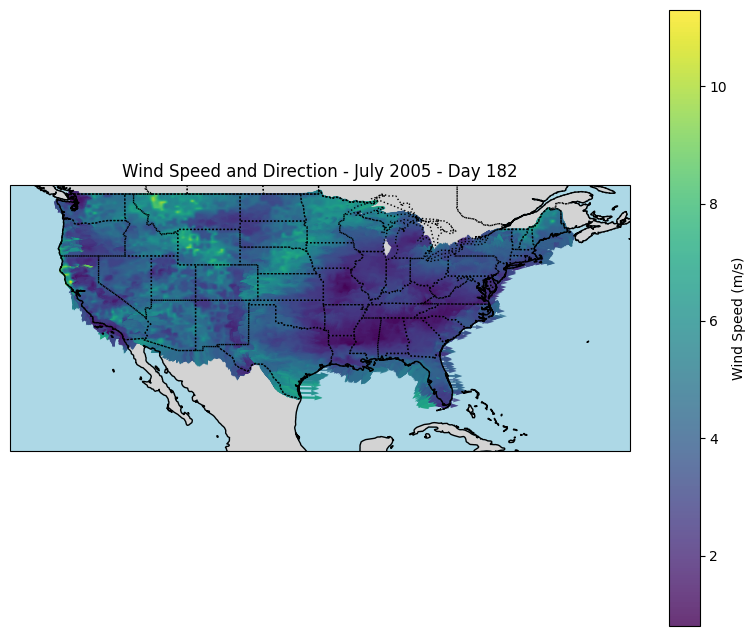

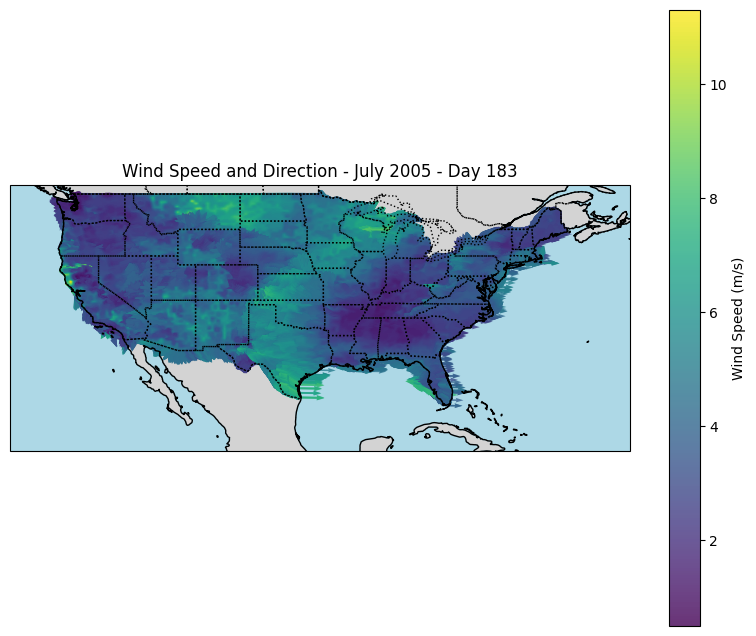

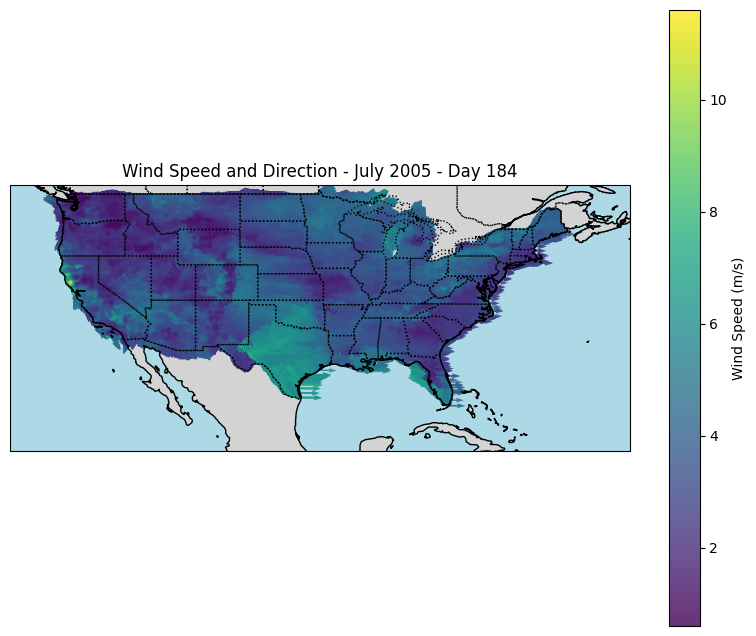

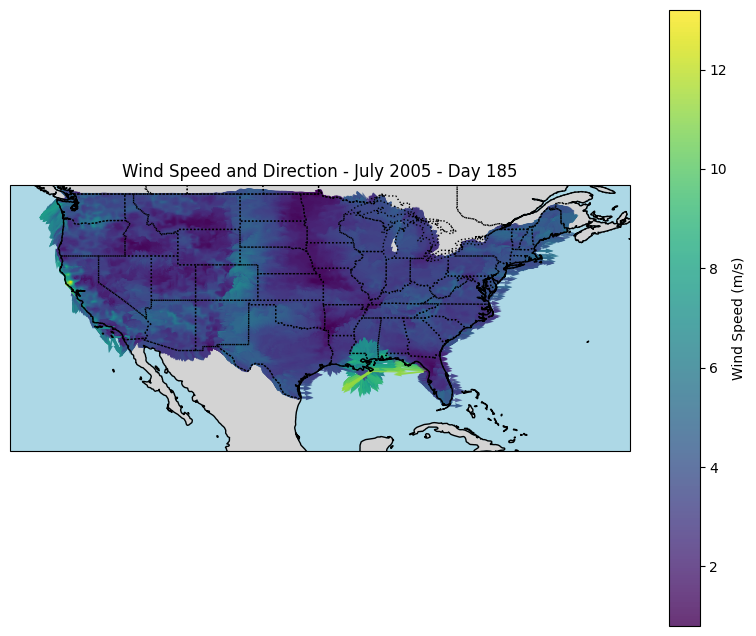

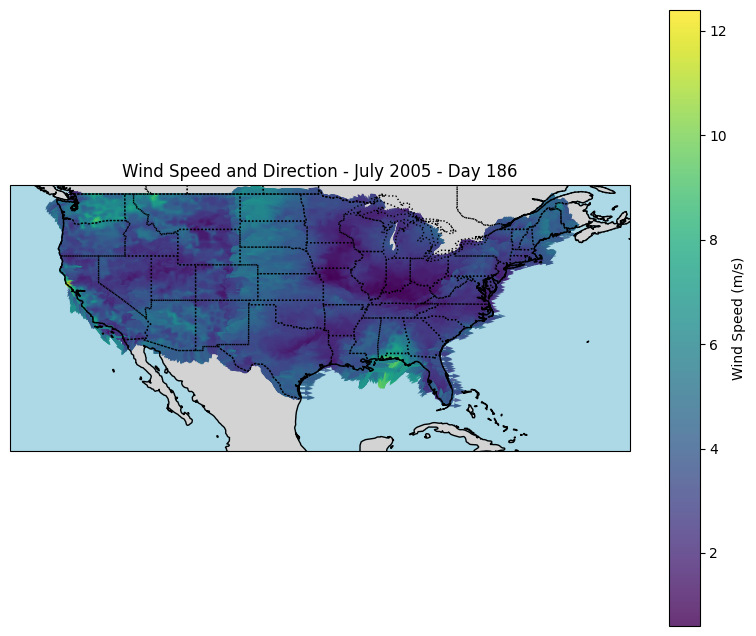

...

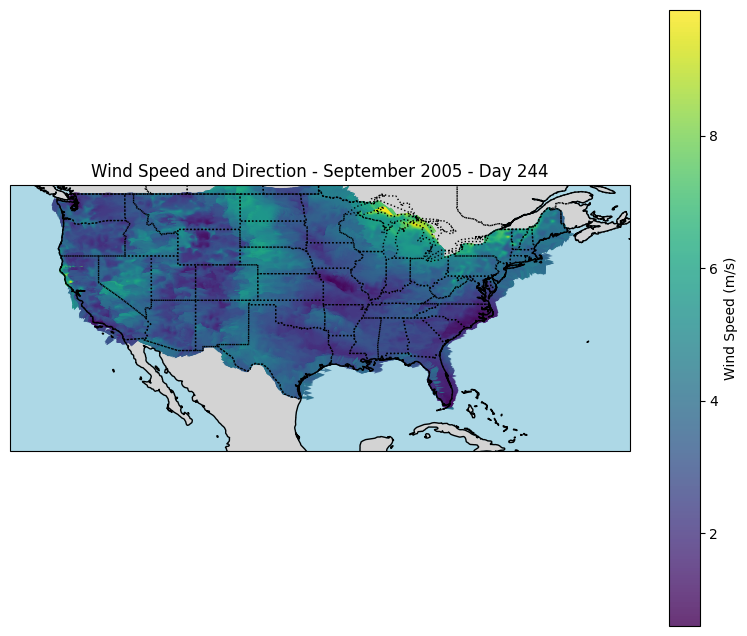

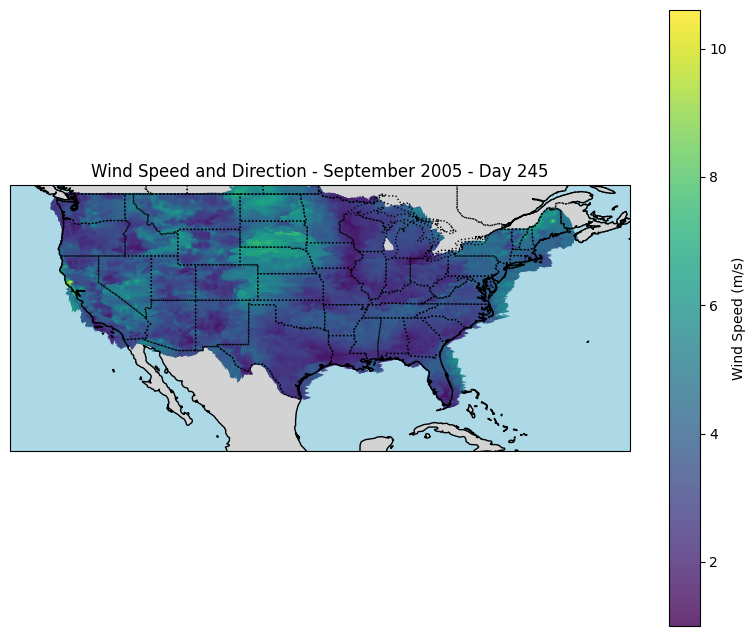

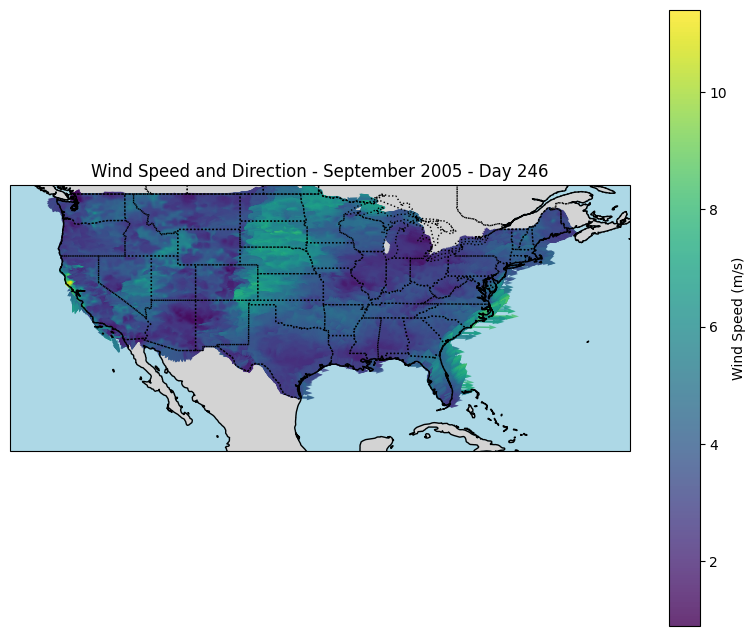

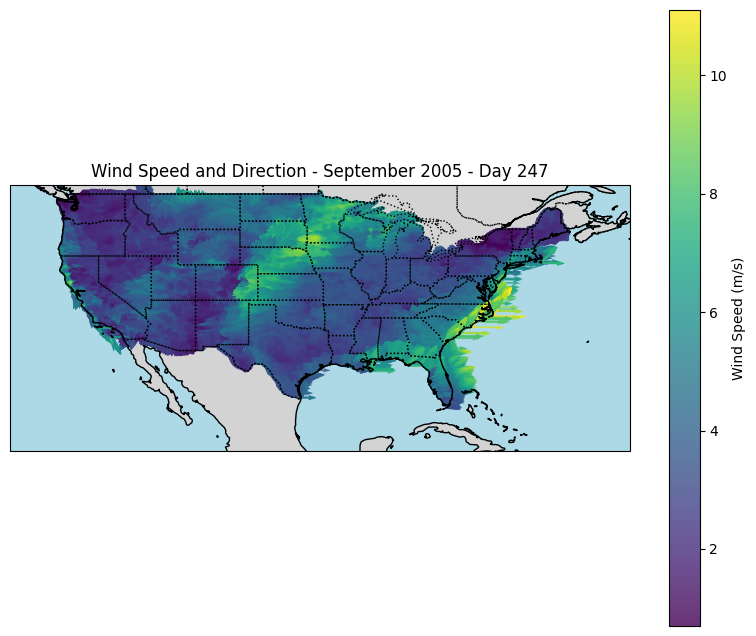

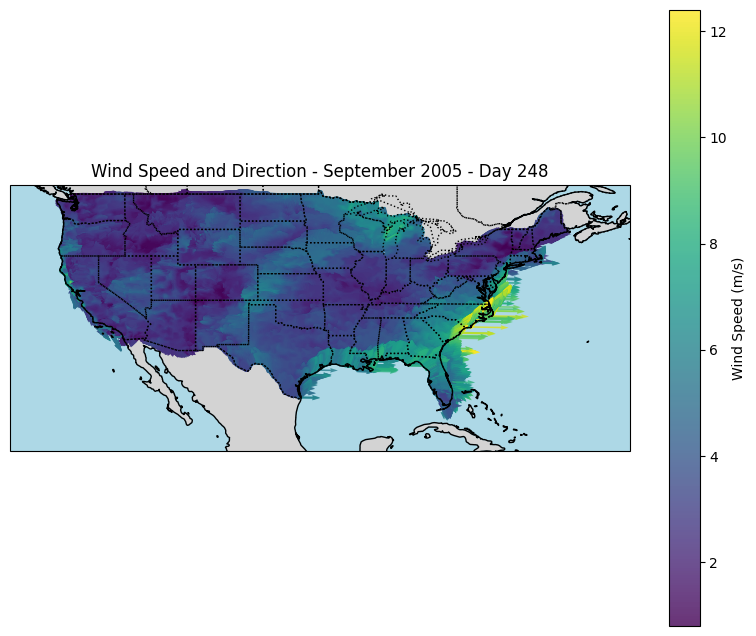

In [2]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# Load the .nc files for wind speed and direction
wind_speed = xr.open_dataset('vs_2005.nc')  # Replace with actual file path if needed
wind_dir = xr.open_dataset('th_2005.nc')    # Replace with actual file path if needed

# Define the specific days to plot for each month
day_to_month = {
    'July': list(range(182, 187)),     # First 5 days of July
    'August': list(range(213, 218)),   # First 5 days of August
    'September': list(range(244, 249)) # First 5 days of September
}

# Assuming latitude and longitude coordinates are available as 'lat' and 'lon' in the dataset
lat = wind_speed['lat'].values
lon = wind_speed['lon'].values

# Define a colormap for different wind speed magnitudes
cmap = plt.cm.viridis  # Using 'viridis' colormap for good perceptual contrast

# Loop through each month and plot for each day separately
for month, days in day_to_month.items():
    for day in days:
        # Select wind speed and direction for the specific day
        wind_speed_day = wind_speed['wind_speed'].isel(day=day)
        wind_dir_day = wind_dir['wind_from_direction'].isel(day=day)

        # Convert direction and speed to u and v components
        wind_dir_rad = np.deg2rad(wind_dir_day)
        u = wind_speed_day * np.cos(wind_dir_rad)
        v = wind_speed_day * np.sin(wind_dir_rad)

        # Create a Cartopy plot with the U.S. map
        plt.figure(figsize=(10, 8))
        ax = plt.axes(projection=ccrs.PlateCarree())
        ax.set_extent([-130, -60, 20, 50], crs=ccrs.PlateCarree())  # Set map extent to U.S.

        # Add map features and apply distinct colors
        ax.add_feature(cfeature.COASTLINE, edgecolor='black')
        ax.add_feature(cfeature.BORDERS, linestyle=':', edgecolor='black')
        ax.add_feature(cfeature.STATES, linestyle=':', edgecolor='black')
        ax.add_feature(cfeature.LAND, color='lightgrey')  # Light grey land surface color
        ax.add_feature(cfeature.OCEAN, color='lightblue')  # Light blue ocean color

        # Plot the quiver plot, using wind speed values to color the arrows
        q = plt.quiver(
            lon, lat, u, v,
            wind_speed_day,  # Use wind speed values for color mapping
            transform=ccrs.PlateCarree(),
            scale=200, cmap=cmap, alpha=0.8, width=0.0025
        )

        # Add color bar to show wind speed scale
        plt.colorbar(q, label='Wind Speed (m/s)', orientation='vertical')

        plt.title(f'Wind Speed and Direction - {month} 2005 - Day {day}')
        plt.show()


/var/folders/nt/xg5gfpkj58vgy8hqhlsslg_m0000gn/T/ipykernel_92953/1966510068.py:63: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.03, 1, 0.97])


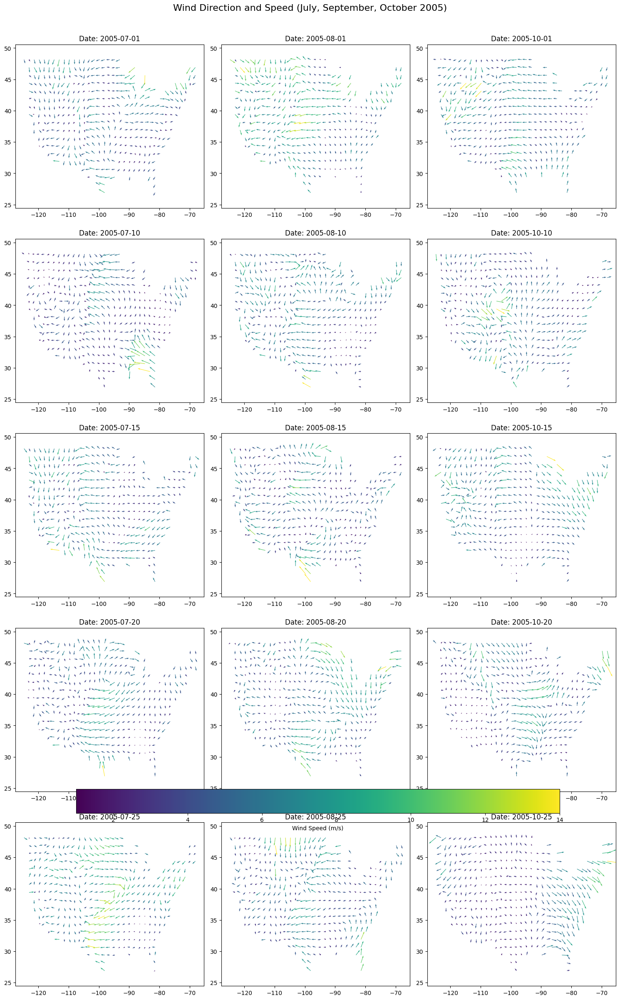

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates


import xarray as xr

# Load the .nc files for wind speed (vs) and wind direction (th)
vs_file_path = 'vs_2005.nc'
th_file_path = 'th_2005.nc'

# Open the datasets
vs_data = xr.open_dataset(vs_file_path)
th_data = xr.open_dataset(th_file_path)

# Inspect the datasets to understand their structure
vs_data_info = vs_data
th_data_info = th_data
vs_data_info, th_data_info

# Define the days for each month to plot (5 days in July, August, September)
days_july = ["2005-07-01", "2005-07-10", "2005-07-15", "2005-07-20", "2005-07-25"]
days_september = ["2005-08-01", "2005-08-10", "2005-08-15", "2005-08-20", "2005-08-25"]
days_october = ["2005-10-01", "2005-10-10", "2005-10-15", "2005-10-20", "2005-10-25"]
selected_days = days_july + days_september + days_october

# Extract data for selected days
vs_selected = vs_data.sel(day=selected_days)
th_selected = th_data.sel(day=selected_days)

# Prepare quiver plots
fig, axes = plt.subplots(5, 3, figsize=(15, 25), subplot_kw={'projection': None})
fig.suptitle("Wind Direction and Speed (July, September, October 2005)", fontsize=16)

for i, day in enumerate(selected_days):
    ax = axes[i % 5, i // 5]
    
    # Get wind speed and direction data for the day
    wind_speed = vs_selected.wind_speed.sel(day=day)
    wind_direction = th_selected.wind_from_direction.sel(day=day)
    
    # Convert direction (degrees) to radians for U and V wind component calculations
    theta = np.deg2rad(wind_direction)
    u = wind_speed * np.cos(theta)
    v = wind_speed * np.sin(theta)
    
    # Select a subset of data for visualization (sparse for clarity)
    lon = wind_speed.lon[::40]  # Sample every 40th for better visualization
    lat = wind_speed.lat[::30]
    u = u[::30, ::40]
    v = v[::30, ::40]
    speed = wind_speed[::30, ::40]
    
    # Plot the quiver
    quiver = ax.quiver(lon, lat, u, v, speed, cmap='viridis')
    ax.set_title(f"Date: {day}")

    # Add color bar
    if i == len(selected_days) - 1:
        cbar = fig.colorbar(quiver, ax=axes[:, :], orientation='horizontal', pad=0.05)
        cbar.set_label("Wind Speed (m/s)")

plt.tight_layout(rect=[0, 0.03, 1, 0.97])
plt.show()


/var/folders/nt/xg5gfpkj58vgy8hqhlsslg_m0000gn/T/ipykernel_92953/2966507311.py:55: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.03, 0.9, 0.97])


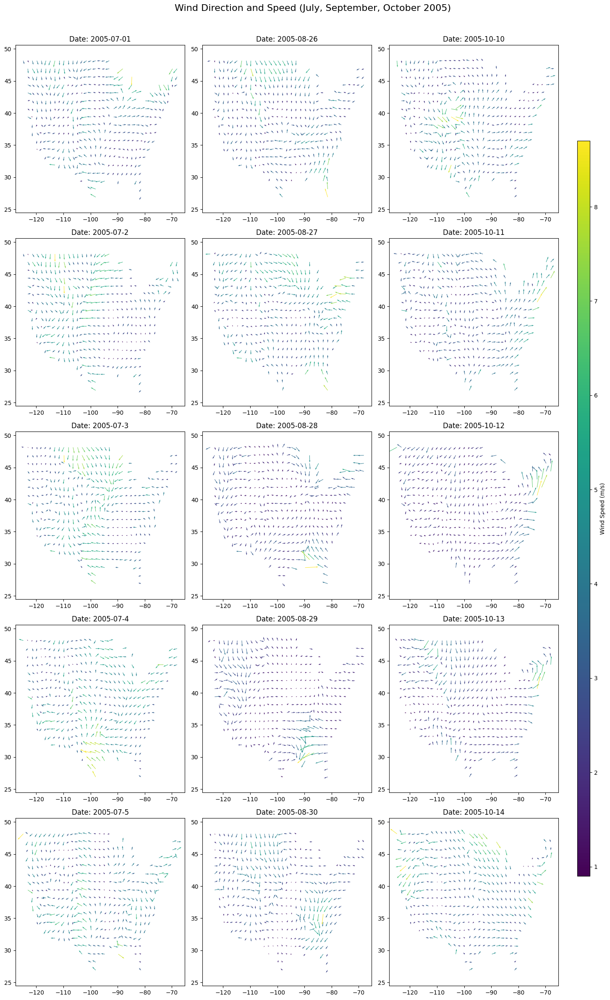

In [4]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr

# Load the .nc files for wind speed (vs) and wind direction (th)
vs_file_path = 'vs_2005.nc'
th_file_path = 'th_2005.nc'

# Open the datasets
vs_data = xr.open_dataset(vs_file_path)
th_data = xr.open_dataset(th_file_path)

# Define the days for each month to plot (5 days in July, August, September)
days_july = ["2005-07-01", "2005-07-2", "2005-07-3", "2005-07-4", "2005-07-5"]
days_september = ["2005-08-26", "2005-08-27", "2005-08-28", "2005-08-29", "2005-08-30"]
days_october = ["2005-10-10", "2005-10-11", "2005-10-12", "2005-10-13", "2005-10-14"]
selected_days = days_july + days_september + days_october

# Extract data for selected days
vs_selected = vs_data.sel(day=selected_days)
th_selected = th_data.sel(day=selected_days)

# Prepare quiver plots
fig, axes = plt.subplots(5, 3, figsize=(15, 25), subplot_kw={'projection': None})
fig.suptitle("Wind Direction and Speed (July, September, October 2005)", fontsize=16)

for i, day in enumerate(selected_days):
    ax = axes[i % 5, i // 5]
    
    # Get wind speed and direction data for the day
    wind_speed = vs_selected.wind_speed.sel(day=day)
    wind_direction = th_selected.wind_from_direction.sel(day=day)
    
    # Convert direction (degrees) to radians for U and V wind component calculations
    theta = np.deg2rad(wind_direction)
    u = wind_speed * np.cos(theta)
    v = wind_speed * np.sin(theta)
    
    # Select a subset of data for visualization (sparse for clarity)
    lon = wind_speed.lon[::40]  # Sample every 40th for better visualization
    lat = wind_speed.lat[::30]
    u = u[::30, ::40]
    v = v[::30, ::40]
    speed = wind_speed[::30, ::40]
    
    # Plot the quiver
    quiver = ax.quiver(lon, lat, u, v, speed, cmap='viridis')
    ax.set_title(f"Date: {day}")

# **Changed part: Adding color bar on the side**
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # Adjusted position for side placement
cbar = fig.colorbar(quiver, cax=cbar_ax)
cbar.set_label("Wind Speed (m/s)")

plt.tight_layout(rect=[0, 0.03, 0.9, 0.97])
plt.show()


/var/folders/nt/xg5gfpkj58vgy8hqhlsslg_m0000gn/T/ipykernel_92953/2838822593.py:61: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.03, 0.9, 0.97])


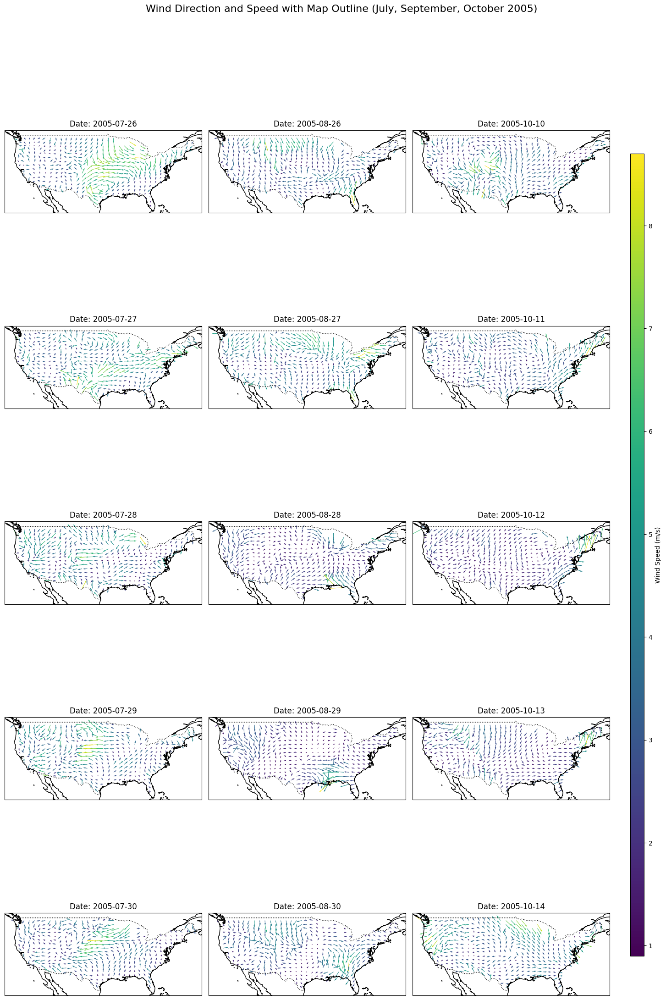

In [5]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr
import cartopy.crs as ccrs  # Import for map projections and coastlines
import cartopy.feature as cfeature

# Load the .nc files for wind speed (vs) and wind direction (th)
vs_file_path = 'vs_2005.nc'
th_file_path = 'th_2005.nc'

# Open the datasets
vs_data = xr.open_dataset(vs_file_path)
th_data = xr.open_dataset(th_file_path)

# Define the days for each month to plot (5 days in July, August, September)
days_july = ["2005-07-26", "2005-07-27", "2005-07-28", "2005-07-29", "2005-07-30"]
days_september = ["2005-08-26", "2005-08-27", "2005-08-28", "2005-08-29", "2005-08-30"]
days_october = ["2005-10-10", "2005-10-11", "2005-10-12", "2005-10-13", "2005-10-14"]
selected_days = days_july + days_september + days_october

# Extract data for selected days
vs_selected = vs_data.sel(day=selected_days)
th_selected = th_data.sel(day=selected_days)

# Prepare quiver plots with cartopy projection
fig, axes = plt.subplots(5, 3, figsize=(15, 25), subplot_kw={'projection': ccrs.PlateCarree()})
fig.suptitle("Wind Direction and Speed with Map Outline (July, September, October 2005)", fontsize=16)

for i, day in enumerate(selected_days):
    ax = axes[i % 5, i // 5]
    
    # Get wind speed and direction data for the day
    wind_speed = vs_selected.wind_speed.sel(day=day)
    wind_direction = th_selected.wind_from_direction.sel(day=day)
    
    # Convert direction (degrees) to radians for U and V wind component calculations
    theta = np.deg2rad(wind_direction)
    u = wind_speed * np.cos(theta)
    v = wind_speed * np.sin(theta)
    
    # Select a subset of data for visualization (sparse for clarity)
    lon = wind_speed.lon[::40]  # Sample every 40th for better visualization
    lat = wind_speed.lat[::30]
    u = u[::30, ::40]
    v = v[::30, ::40]
    speed = wind_speed[::30, ::40]
    
    # Plot the quiver with map outlines
    quiver = ax.quiver(lon, lat, u, v, speed, cmap='viridis', transform=ccrs.PlateCarree())
    ax.set_title(f"Date: {day}")
    
    # Add map features
    ax.coastlines()  # Add coastlines
    ax.add_feature(cfeature.BORDERS, linestyle=':')  # Add borders

# Color bar on the side
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # Adjusted position for side placement
cbar = fig.colorbar(quiver, cax=cbar_ax)
cbar.set_label("Wind Speed (m/s)")

plt.tight_layout(rect=[0, 0.03, 0.9, 0.97])
plt.show()


/var/folders/nt/xg5gfpkj58vgy8hqhlsslg_m0000gn/T/ipykernel_92953/3663302307.py:69: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.03, 0.88, 0.97])  # Adjusted to give more space to the side plots


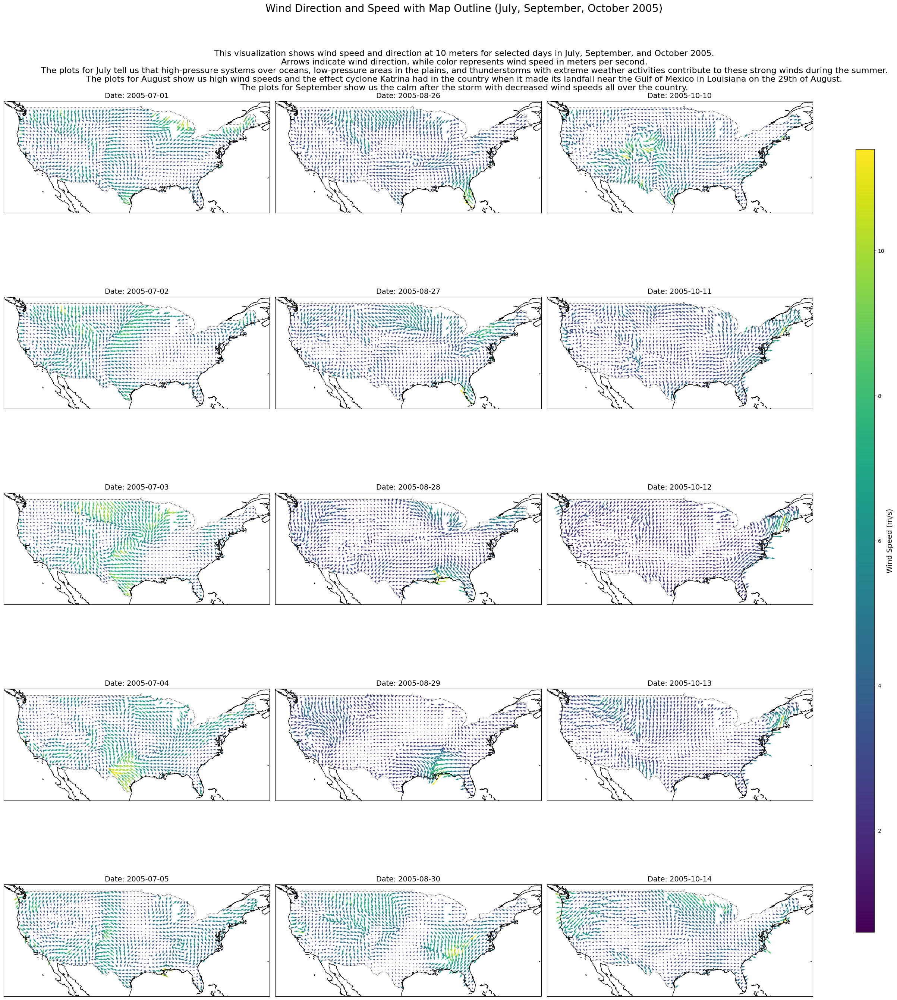

In [6]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr
import cartopy.crs as ccrs  # Import for map projections and coastlines
import cartopy.feature as cfeature

# Load the .nc files for wind speed (vs) and wind direction (th)
vs_file_path = 'vs_2005.nc'
th_file_path = 'th_2005.nc'

# Open the datasets
vs_data = xr.open_dataset(vs_file_path)
th_data = xr.open_dataset(th_file_path)

# Define the days for each month to plot (5 days in July, August, September)
days_july = ["2005-07-01", "2005-07-02", "2005-07-03", "2005-07-04", "2005-07-05"]
days_september = ["2005-08-26", "2005-08-27", "2005-08-28", "2005-08-29", "2005-08-30"]
days_october = ["2005-10-10", "2005-10-11", "2005-10-12", "2005-10-13", "2005-10-14"]
selected_days = days_july + days_september + days_october

# Extract data for selected days
vs_selected = vs_data.sel(day=selected_days)
th_selected = th_data.sel(day=selected_days)

# Prepare quiver plots with a larger figure size and cartopy projection
fig, axes = plt.subplots(5, 3, figsize=(25, 30), subplot_kw={'projection': ccrs.PlateCarree()})  # Increased figsize for larger plots
fig.suptitle("Wind Direction and Speed with Map Outline (July, September, October 2005)", fontsize=20)

# Adding additional text between the title and plots
fig.text(0.5, 0.92, "This visualization shows wind speed and direction at 10 meters for selected days in July, September, and October 2005.\n"
                    "Arrows indicate wind direction, while color represents wind speed in meters per second.\n"
                    "The plots for July tell us that high-pressure systems over oceans, low-pressure areas in the plains, and thunderstorms with extreme weather activities contribute to these strong winds during the summer.\n"
                    "The plots for August show us high wind speeds and the effect cyclone Katrina had in the country when it made its landfall near the Gulf of Mexico in Louisiana on the 29th of August.\n"
                    "The plots for September show us the calm after the storm with decreased wind speeds all over the country.",
         ha='center', va='center', fontsize=16)

for i, day in enumerate(selected_days):
    ax = axes[i % 5, i // 5]
    
    # Get wind speed and direction data for the day
    wind_speed = vs_selected.wind_speed.sel(day=day)
    wind_direction = th_selected.wind_from_direction.sel(day=day)
    
    # Convert direction (degrees) to radians for U and V wind component calculations
    theta = np.deg2rad(wind_direction)
    u = wind_speed * np.cos(theta)
    v = wind_speed * np.sin(theta)
    
    # Select a subset of data for visualization (sparse for clarity)
    lon = wind_speed.lon[::20]  # Sample every 20th for better visualization
    lat = wind_speed.lat[::20]
    u = u[::20, ::20]
    v = v[::20, ::20]
    speed = wind_speed[::20, ::20]
    
    # Plot the quiver with map outlines
    quiver = ax.quiver(lon, lat, u, v, speed, cmap='viridis', transform=ccrs.PlateCarree())
    ax.set_title(f"Date: {day}", fontsize=14)
    
    # Add map features
    ax.coastlines()  # Add coastlines
    ax.add_feature(cfeature.BORDERS, linestyle=':')  # Add borders

# Color bar on the side
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # Adjusted position for side placement
cbar = fig.colorbar(quiver, cax=cbar_ax)
cbar.set_label("Wind Speed (m/s)", fontsize=14)

plt.tight_layout(rect=[0, 0.03, 0.88, 0.97])  # Adjusted to give more space to the side plots
plt.show()


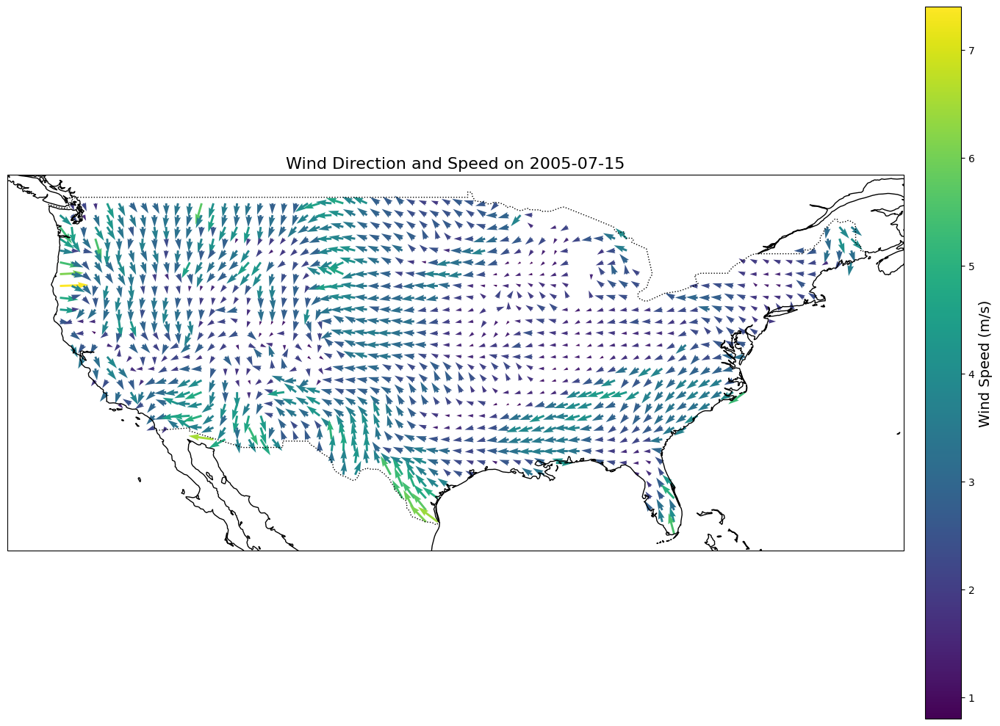

<Figure size 640x480 with 0 Axes>

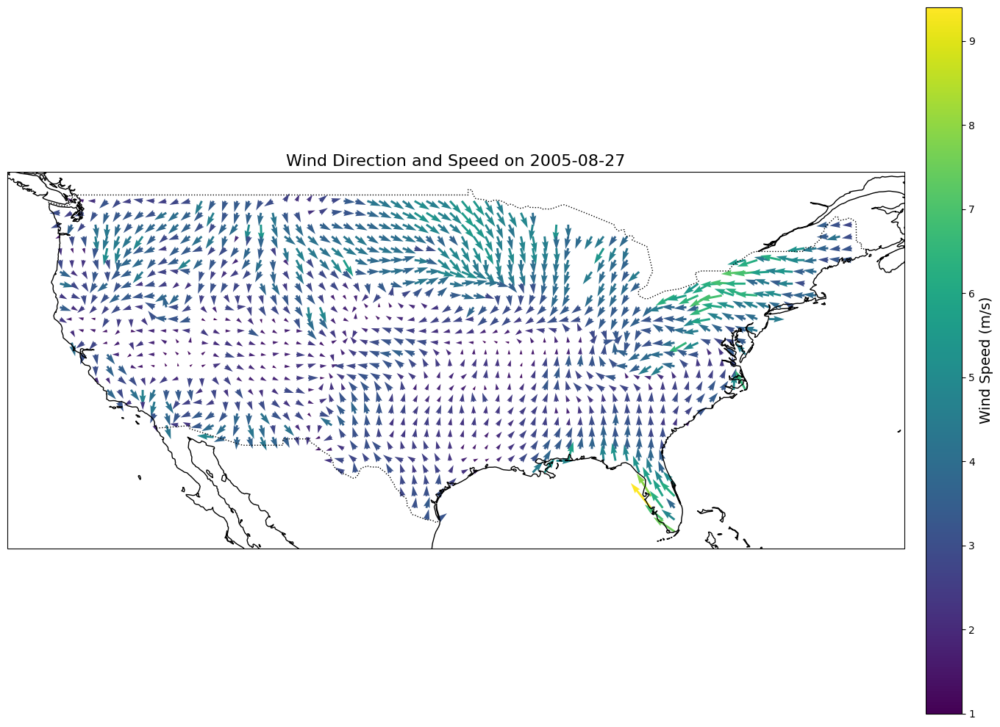

<Figure size 640x480 with 0 Axes>

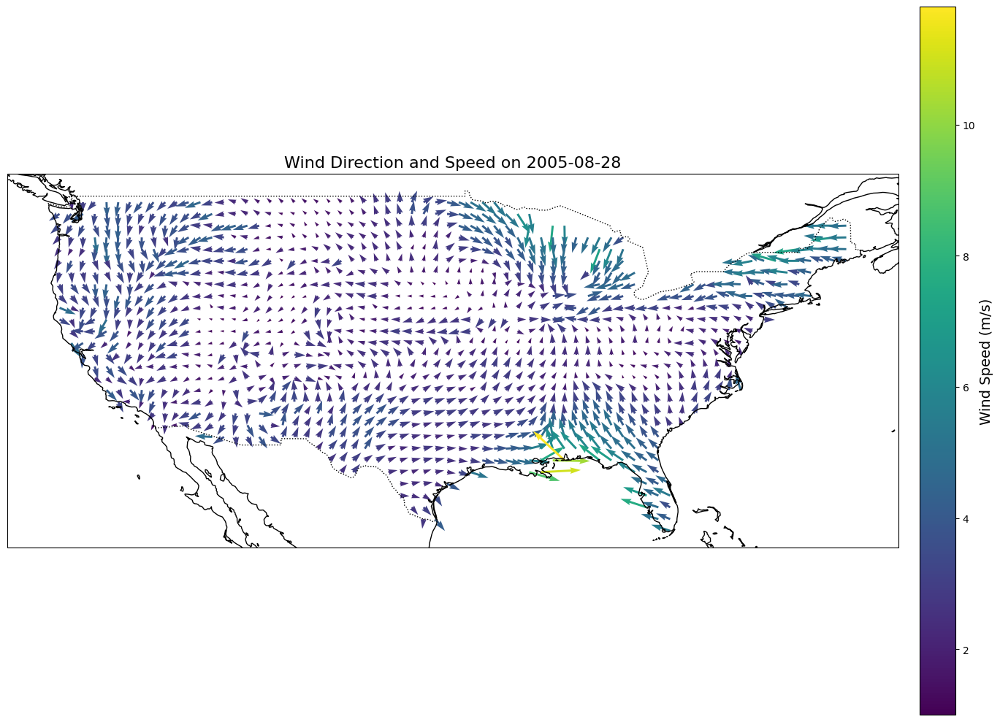

<Figure size 640x480 with 0 Axes>

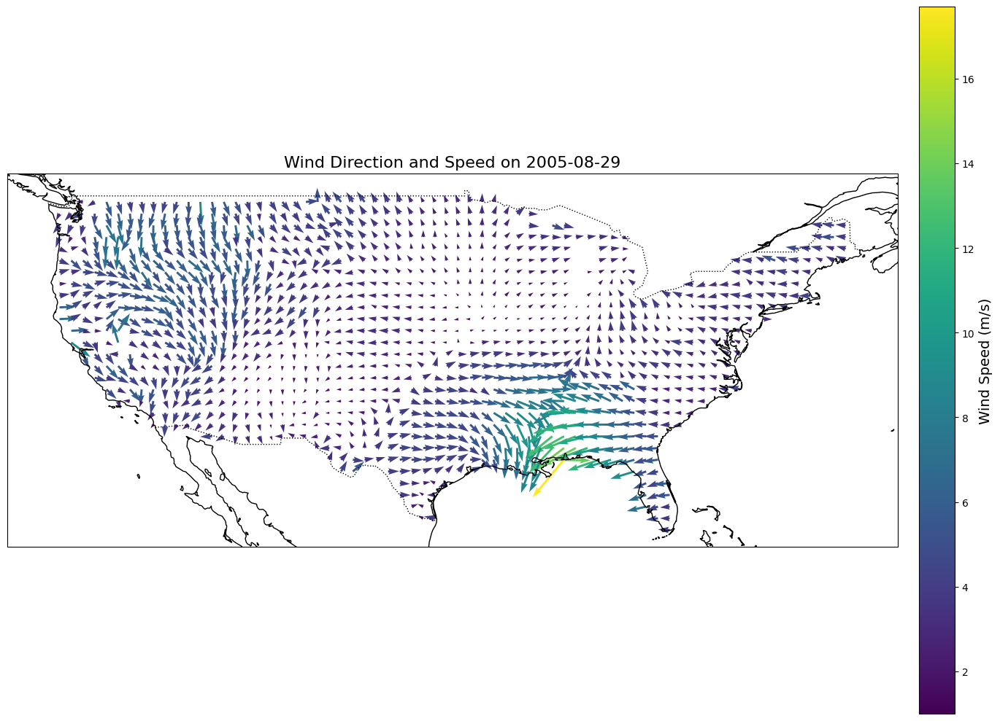

<Figure size 640x480 with 0 Axes>

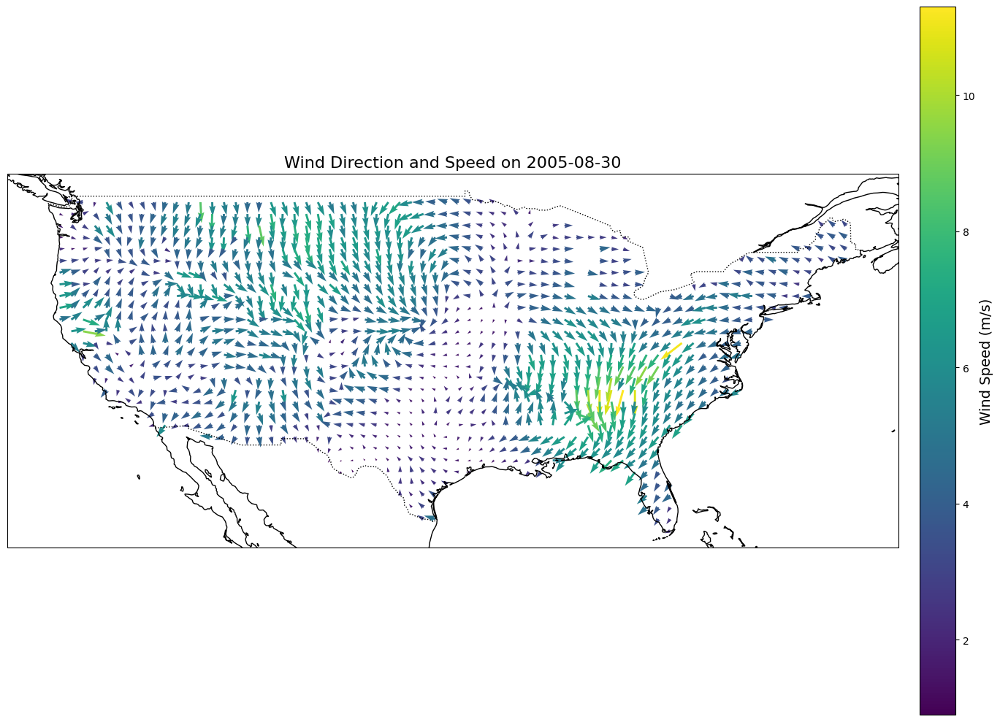

<Figure size 640x480 with 0 Axes>

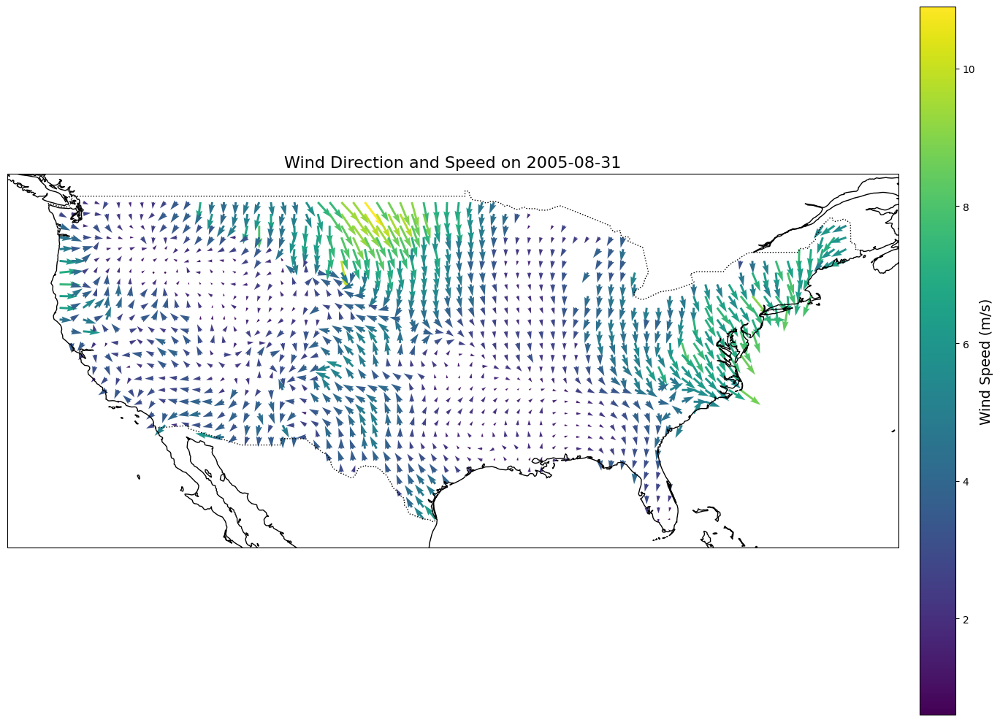

<Figure size 640x480 with 0 Axes>

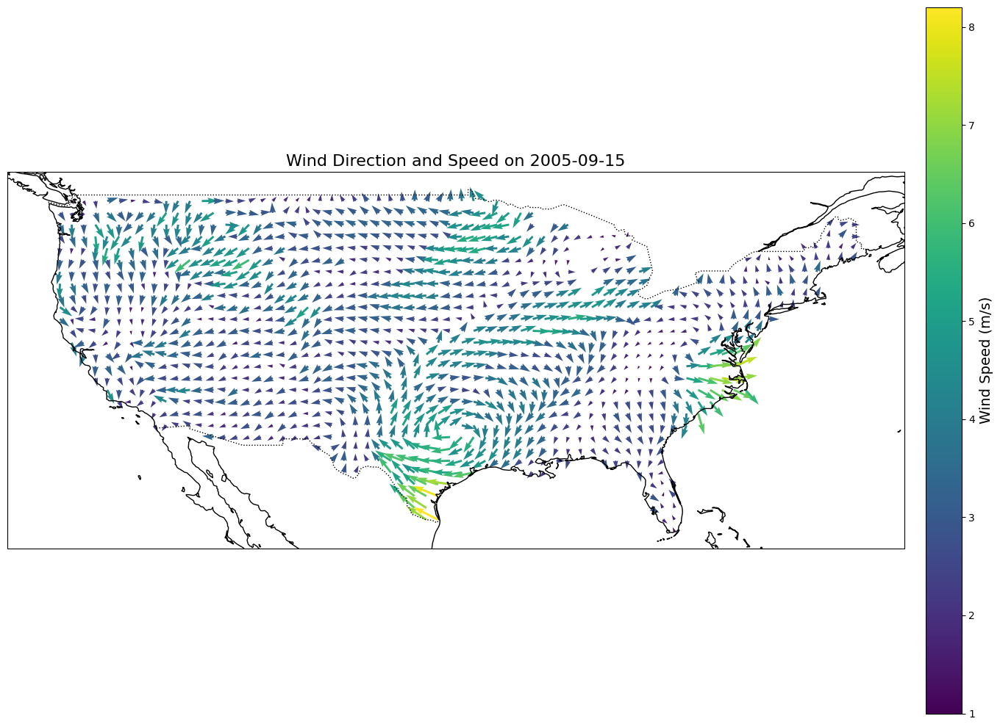

<Figure size 640x480 with 0 Axes>

In [7]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr
import cartopy.crs as ccrs  # Import for map projections and coastlines
import cartopy.feature as cfeature

# Load the .nc files for wind speed (vs) and wind direction (th)
vs_file_path = 'vs_2005.nc'
th_file_path = 'th_2005.nc'

# Open the datasets
vs_data = xr.open_dataset(vs_file_path)
th_data = xr.open_dataset(th_file_path)

# Define the days for each month to plot (5 days in July, August, September)
days_july = ["2005-07-15"]
days_august = ["2005-08-27", "2005-08-28", "2005-08-29", "2005-08-30", "2005-08-31"]
days_september = ["2005-09-15"]
selected_days = days_july + days_august + days_september

# Extract data for selected days
vs_selected = vs_data.sel(day=selected_days)
th_selected = th_data.sel(day=selected_days)

for day in selected_days:
    # Create a new figure for each day
    fig, ax = plt.subplots(figsize=(15, 10), subplot_kw={'projection': ccrs.PlateCarree()})  # Set figure size
    
    # Get wind speed and direction data for the day
    wind_speed = vs_selected.wind_speed.sel(day=day)
    wind_direction = th_selected.wind_from_direction.sel(day=day)
    
    # Convert direction (degrees) to radians for U and V wind component calculations
    theta = np.deg2rad(wind_direction)
    u = wind_speed * np.cos(theta)
    v = wind_speed * np.sin(theta)
    
    # Select a subset of data for visualization (sparse for clarity)
    lon = wind_speed.lon[::20]  # Sample every 20th for better visualization
    lat = wind_speed.lat[::20]
    u = u[::20, ::20]
    v = v[::20, ::20]
    speed = wind_speed[::20, ::20]
    
    # Plot the quiver with map outlines
    quiver = ax.quiver(lon, lat, u, v, speed, cmap='viridis', transform=ccrs.PlateCarree())
    ax.set_title(f"Wind Direction and Speed on {day}", fontsize=16)
    
    # Add map features
    ax.coastlines()  # Add coastlines
    ax.add_feature(cfeature.BORDERS, linestyle=':')  # Add borders

    # Color bar
    cbar = plt.colorbar(quiver, ax=ax, orientation='vertical', pad=0.02)
    cbar.set_label("Wind Speed (m/s)", fontsize=14)

    plt.tight_layout()
    plt.show()  # Display each plot individually

    # Save each plot individually
    plt.savefig(f"wind_close_plot_{day}.png", bbox_inches='tight')  # Save the figure with the date in the filename
    plt.close(fig)  # Close the figure to free memory


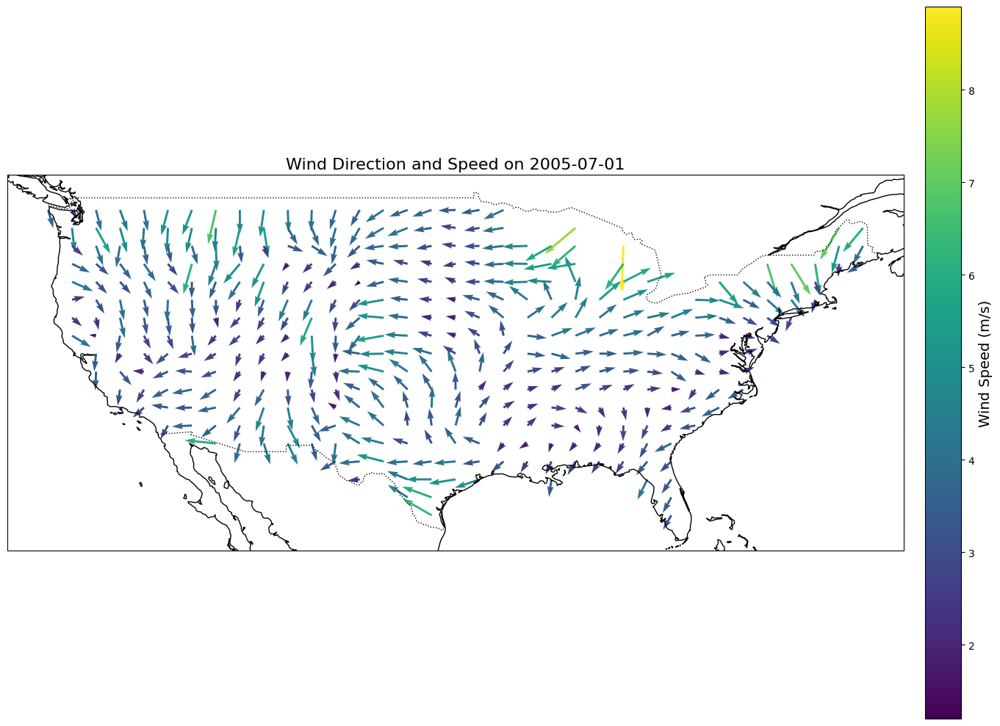

<Figure size 640x480 with 0 Axes>

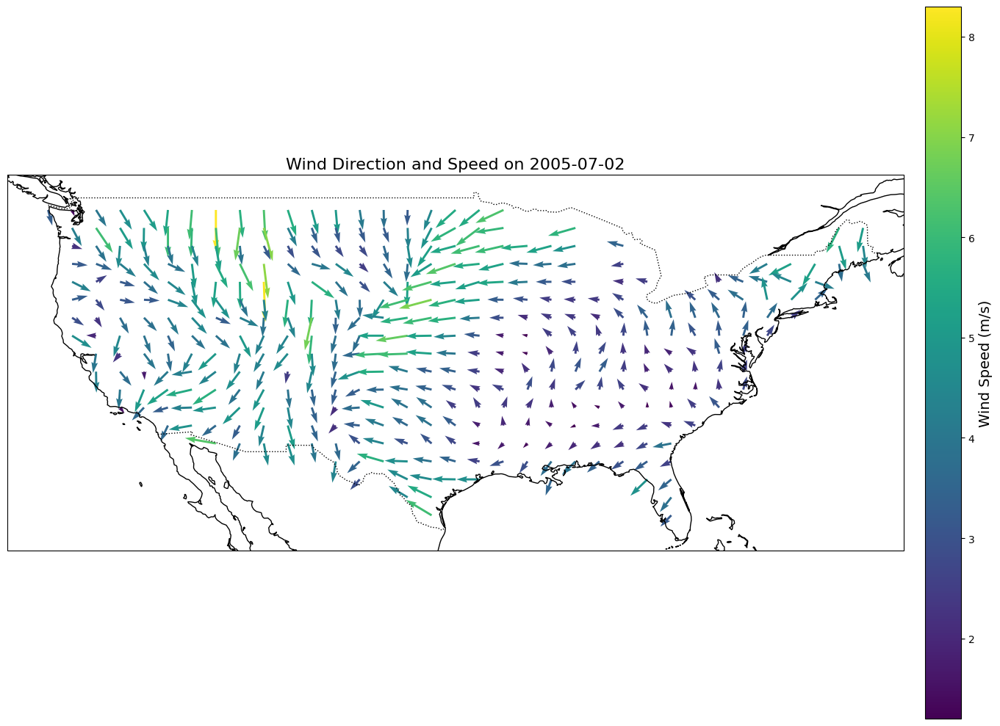

<Figure size 640x480 with 0 Axes>

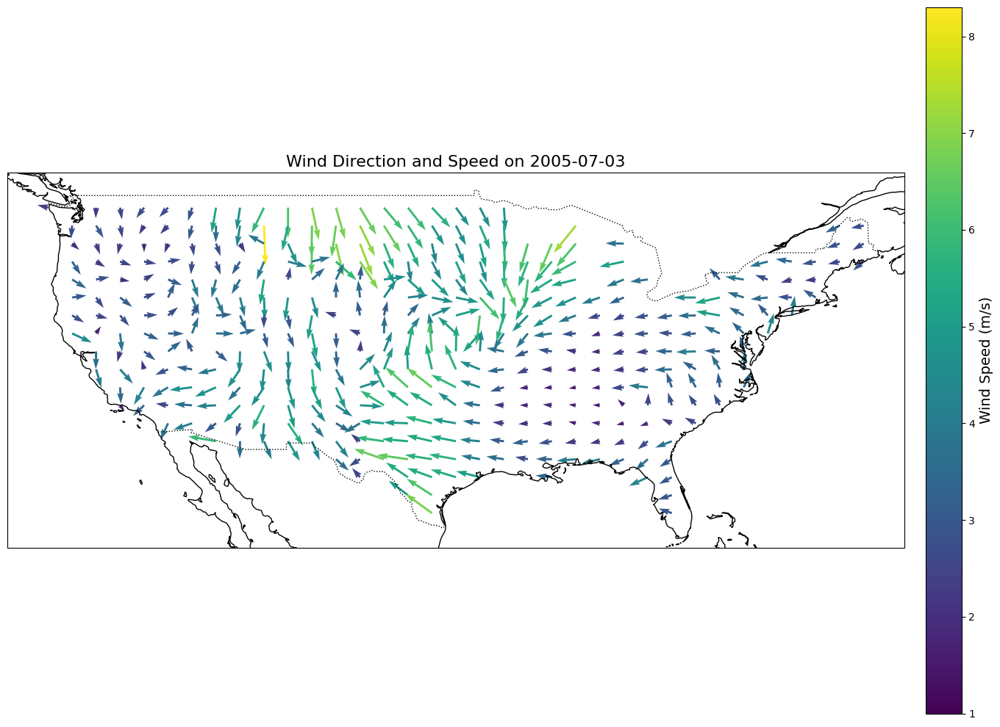

<Figure size 640x480 with 0 Axes>

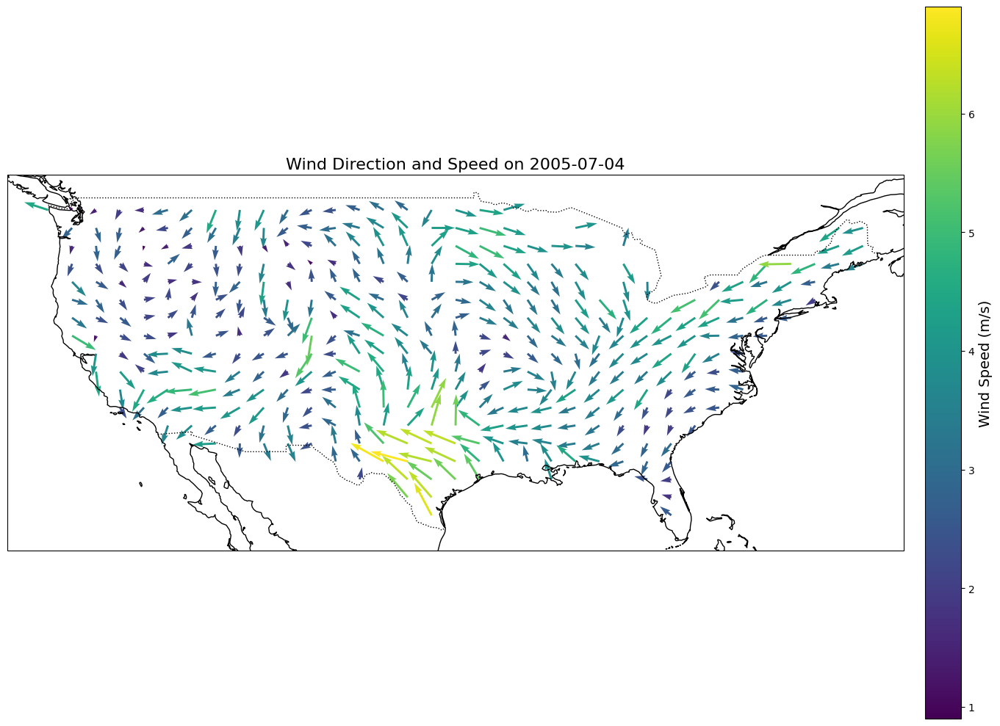

<Figure size 640x480 with 0 Axes>

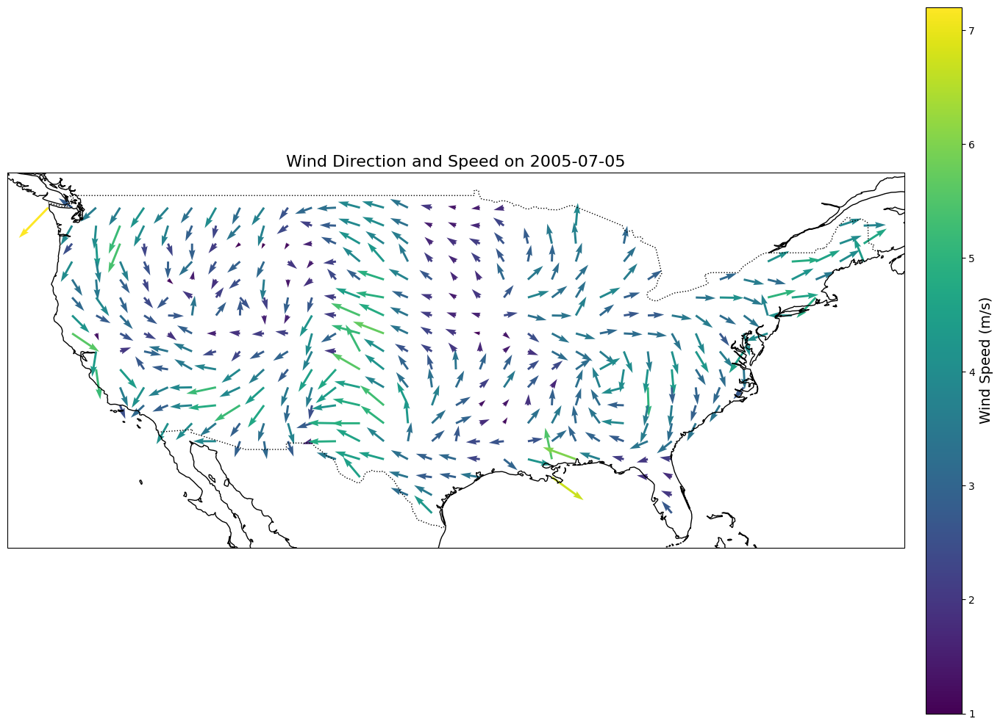

<Figure size 640x480 with 0 Axes>

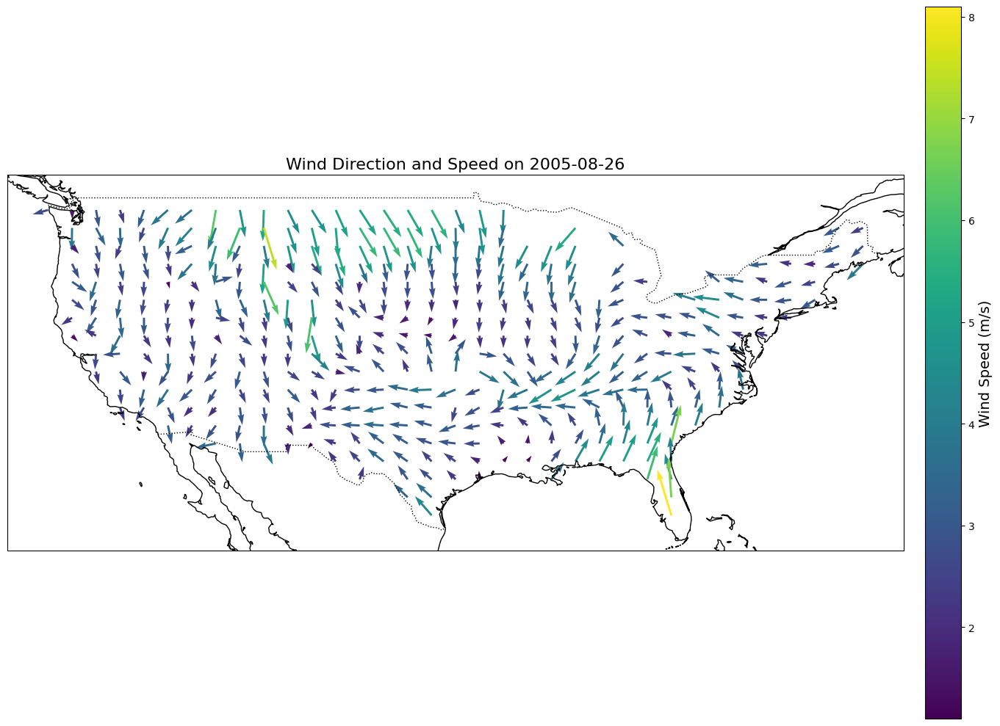

<Figure size 640x480 with 0 Axes>

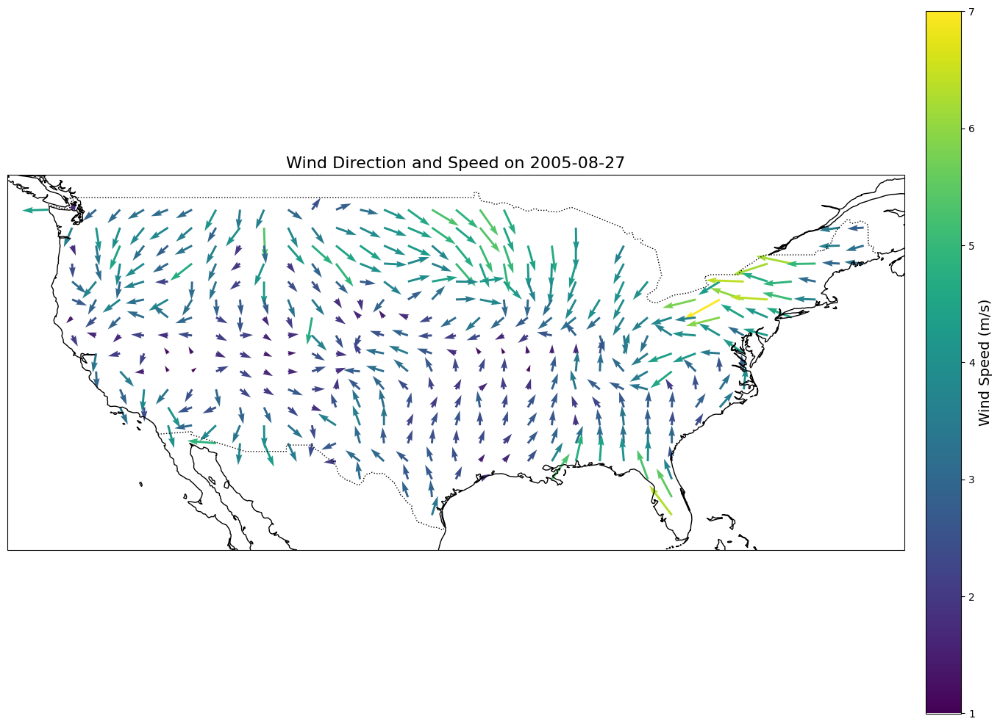

<Figure size 640x480 with 0 Axes>

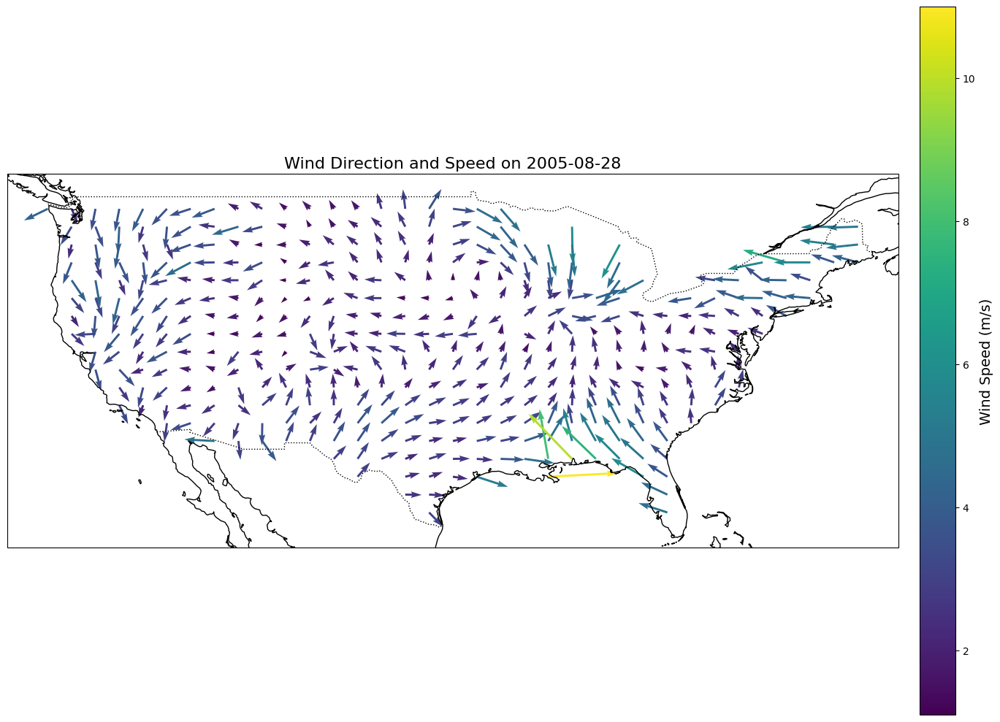

<Figure size 640x480 with 0 Axes>

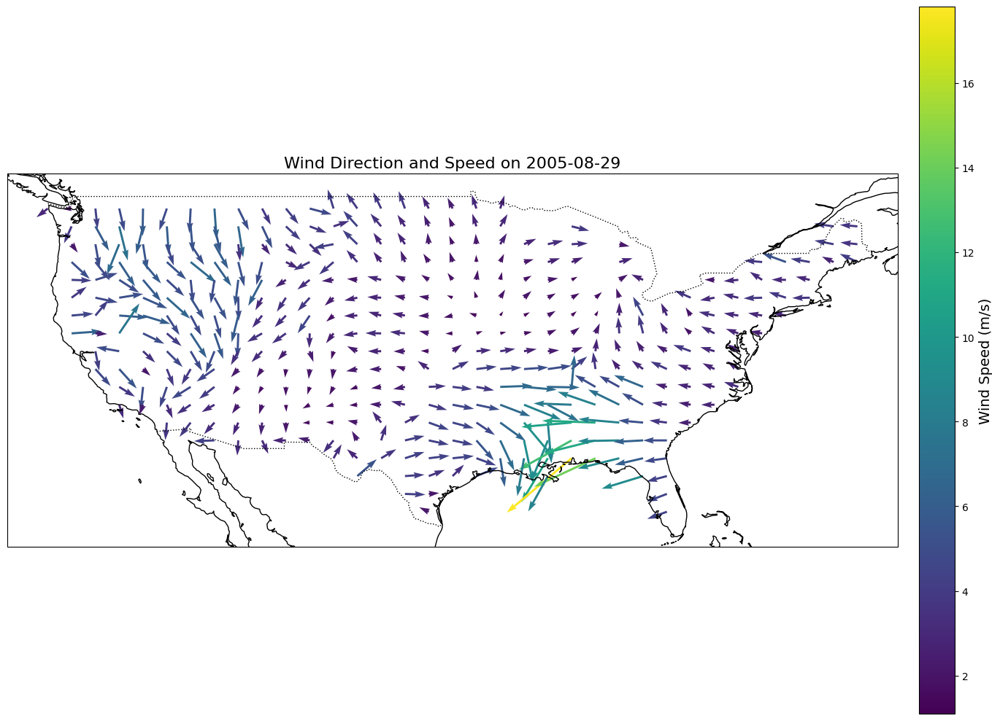

<Figure size 640x480 with 0 Axes>

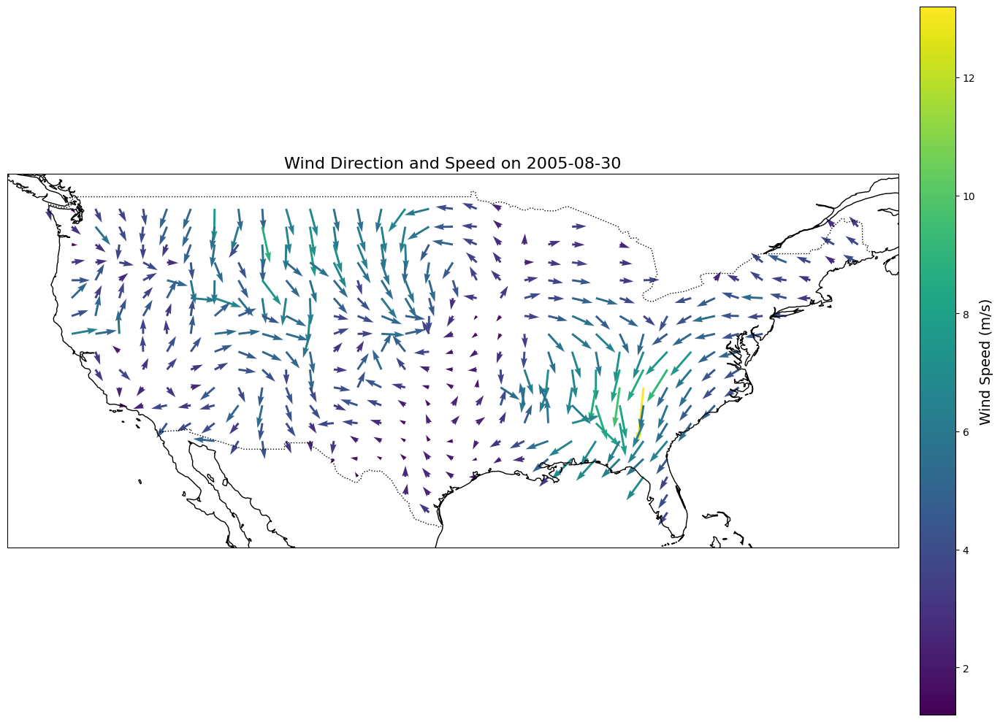

<Figure size 640x480 with 0 Axes>

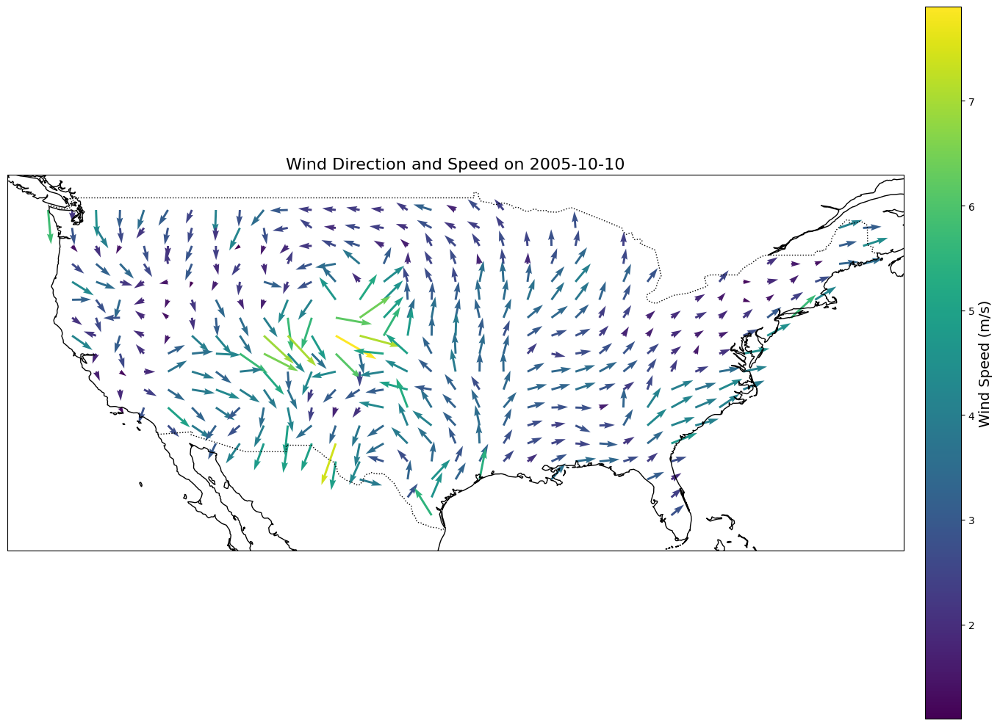

<Figure size 640x480 with 0 Axes>

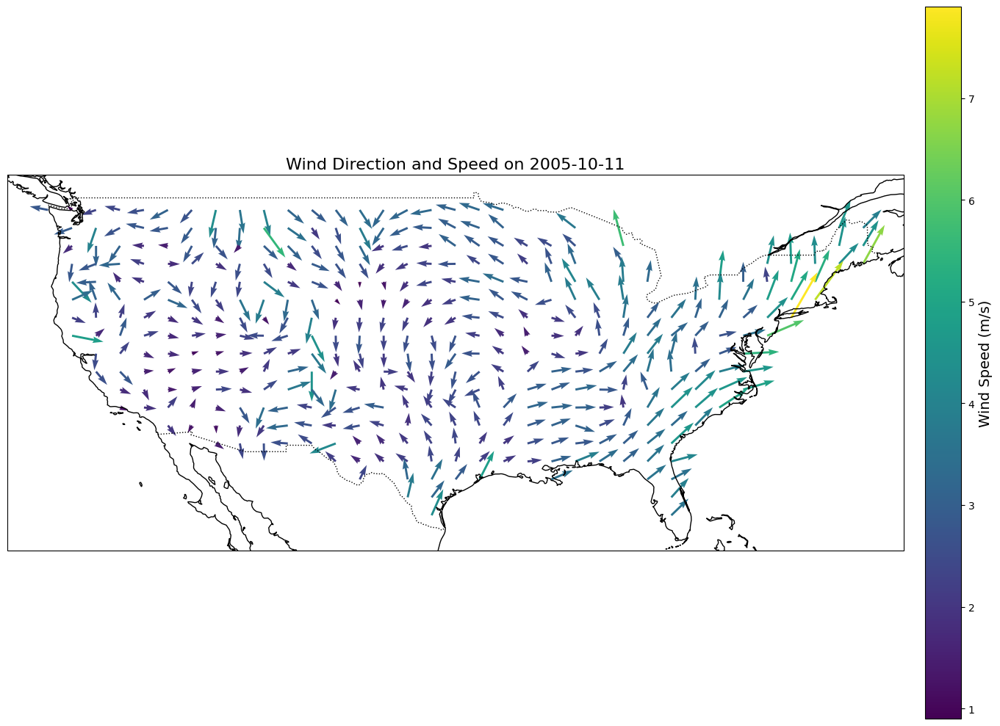

<Figure size 640x480 with 0 Axes>

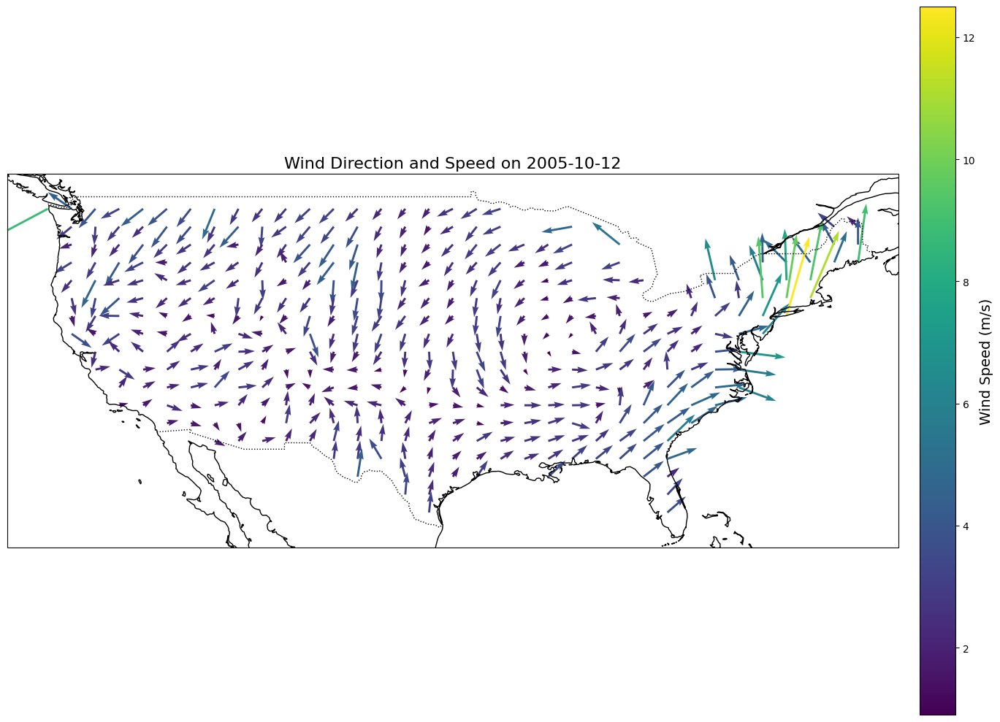

<Figure size 640x480 with 0 Axes>

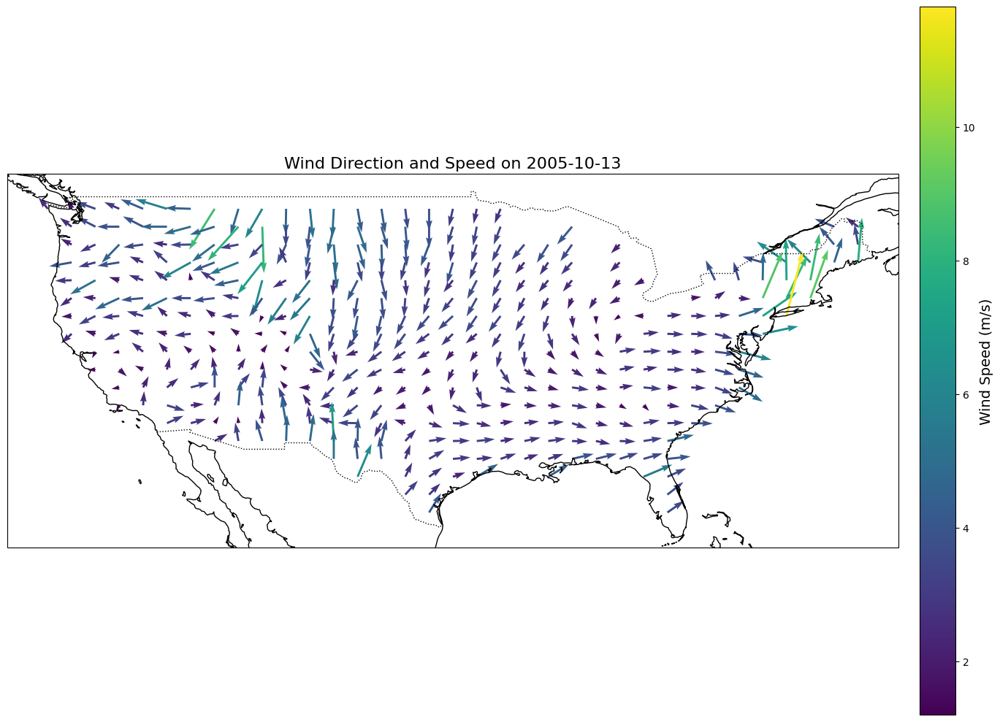

<Figure size 640x480 with 0 Axes>

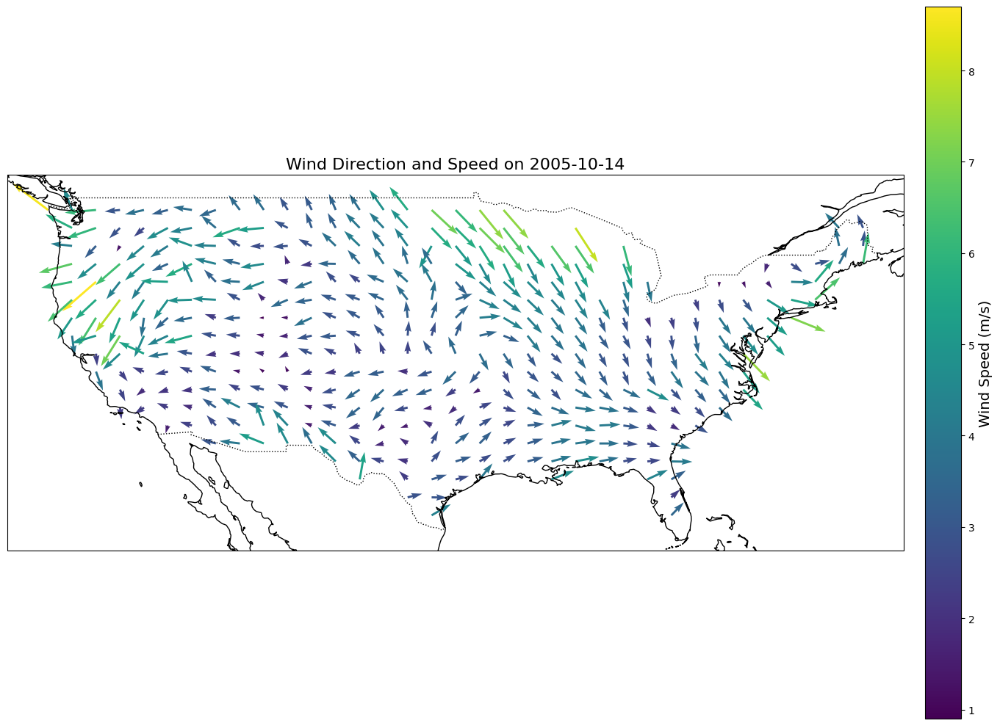

<Figure size 640x480 with 0 Axes>

In [8]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr
import cartopy.crs as ccrs  # Import for map projections and coastlines
import cartopy.feature as cfeature

# Load the .nc files for wind speed (vs) and wind direction (th)
vs_file_path = 'vs_2005.nc'
th_file_path = 'th_2005.nc'

# Open the datasets
vs_data = xr.open_dataset(vs_file_path)
th_data = xr.open_dataset(th_file_path)

# Define the days for each month to plot (5 days in July, August, September)
days_july = ["2005-07-01", "2005-07-02", "2005-07-03", "2005-07-04", "2005-07-05"]
days_september = ["2005-08-26", "2005-08-27", "2005-08-28", "2005-08-29", "2005-08-30"]
days_october = ["2005-10-10", "2005-10-11", "2005-10-12", "2005-10-13", "2005-10-14"]
selected_days = days_july + days_september + days_october

# Extract data for selected days
vs_selected = vs_data.sel(day=selected_days)
th_selected = th_data.sel(day=selected_days)

for day in selected_days:
    # Create a new figure for each day
    fig, ax = plt.subplots(figsize=(15, 10), subplot_kw={'projection': ccrs.PlateCarree()})  # Set figure size
    
    # Get wind speed and direction data for the day
    wind_speed = vs_selected.wind_speed.sel(day=day)
    wind_direction = th_selected.wind_from_direction.sel(day=day)
    
    # Convert direction (degrees) to radians for U and V wind component calculations
    theta = np.deg2rad(wind_direction)
    u = wind_speed * np.cos(theta)
    v = wind_speed * np.sin(theta)
    
    # Select a subset of data for visualization (sparse for clarity)
    lon = wind_speed.lon[::40]  # Sample every 20th for better visualization
    lat = wind_speed.lat[::30]
    u = u[::30, ::40]
    v = v[::30, ::40]
    speed = wind_speed[::30, ::40]
    
    # Plot the quiver with map outlines
    quiver = ax.quiver(lon, lat, u, v, speed, cmap='viridis', transform=ccrs.PlateCarree())
    ax.set_title(f"Wind Direction and Speed on {day}", fontsize=16)
    
    # Add map features
    ax.coastlines()  # Add coastlines
    ax.add_feature(cfeature.BORDERS, linestyle=':')  # Add borders

    # Color bar
    cbar = plt.colorbar(quiver, ax=ax, orientation='vertical', pad=0.02)
    cbar.set_label("Wind Speed (m/s)", fontsize=14)

    plt.tight_layout()
    plt.show()  # Display each plot individually

    # Save each plot individually
    plt.savefig(f"wind_perfect_plot_{day}.png", bbox_inches='tight')  # Save the figure with the date in the filename
    plt.close(fig)  # Close the figure to free memory


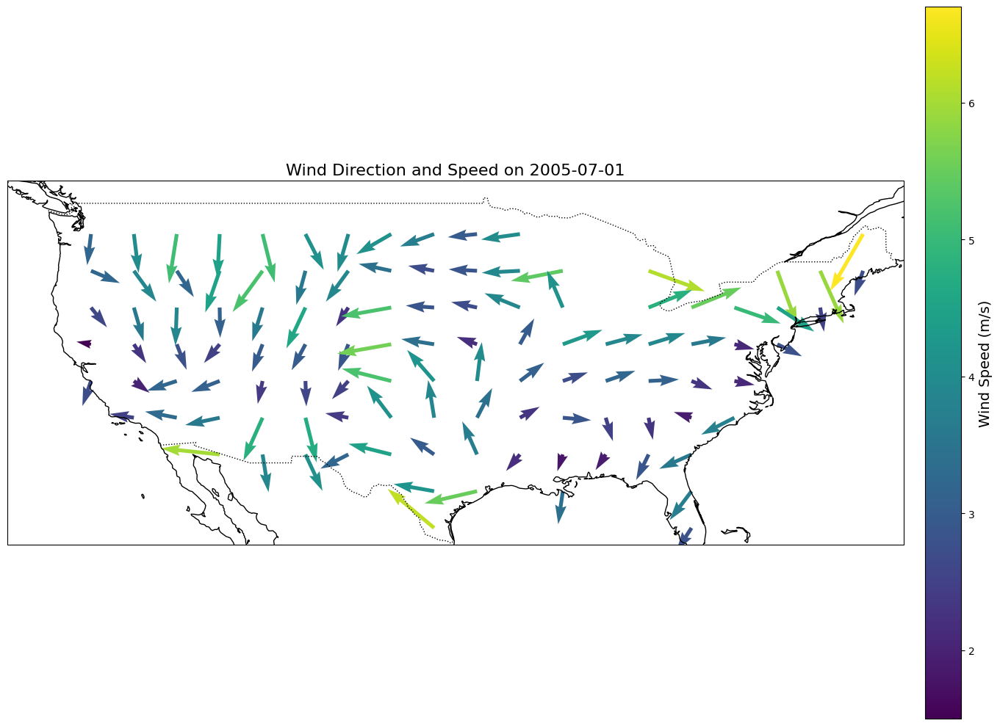

<Figure size 640x480 with 0 Axes>

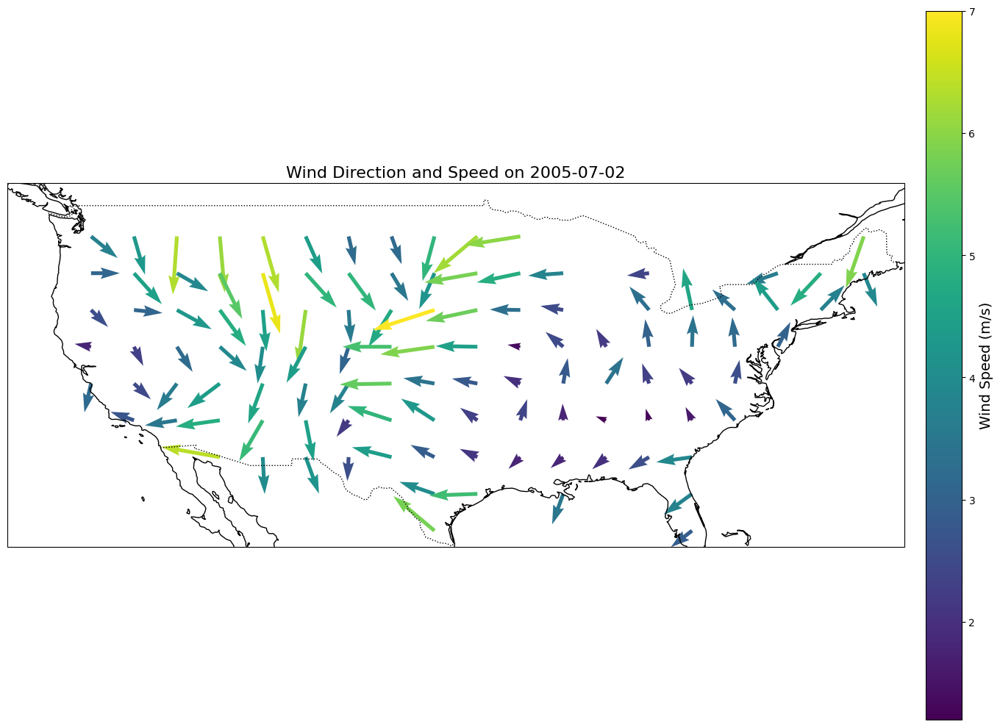

<Figure size 640x480 with 0 Axes>

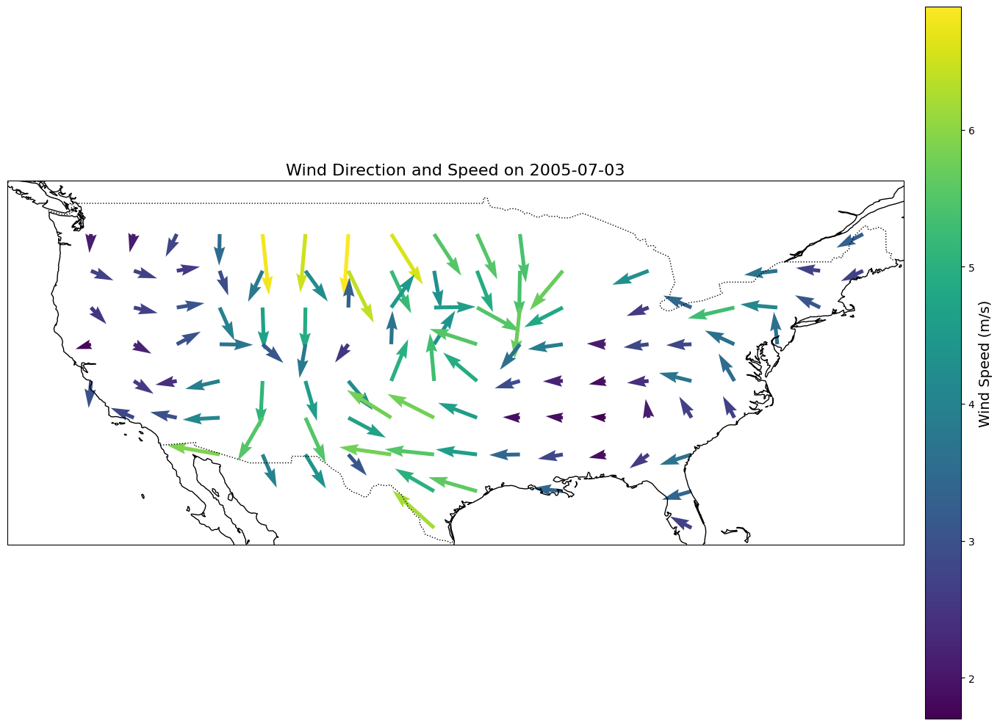

<Figure size 640x480 with 0 Axes>

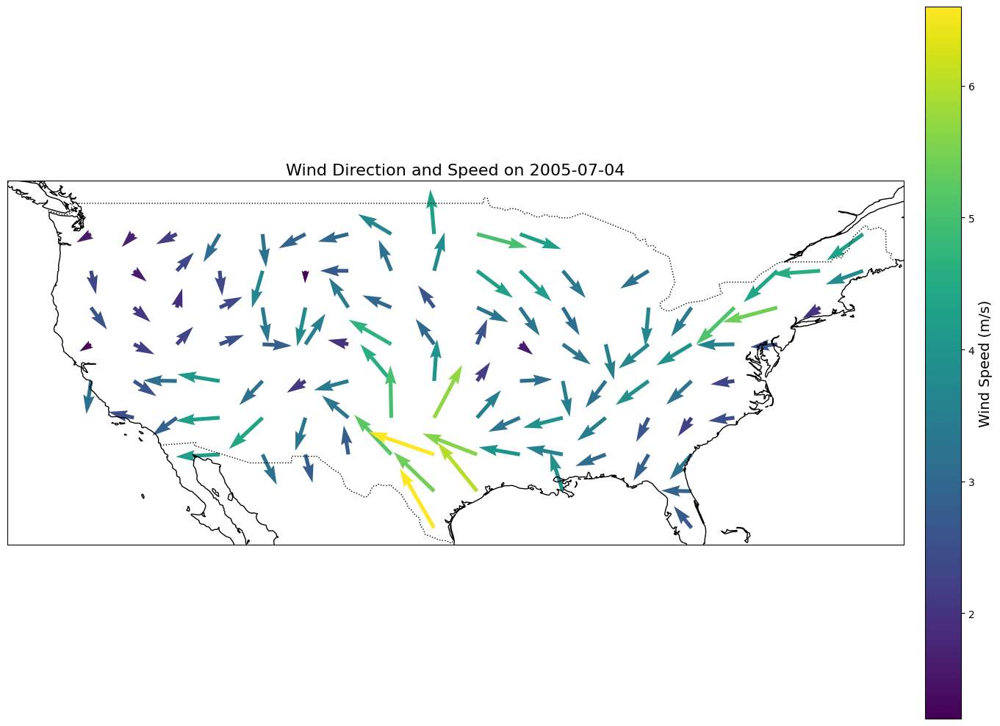

<Figure size 640x480 with 0 Axes>

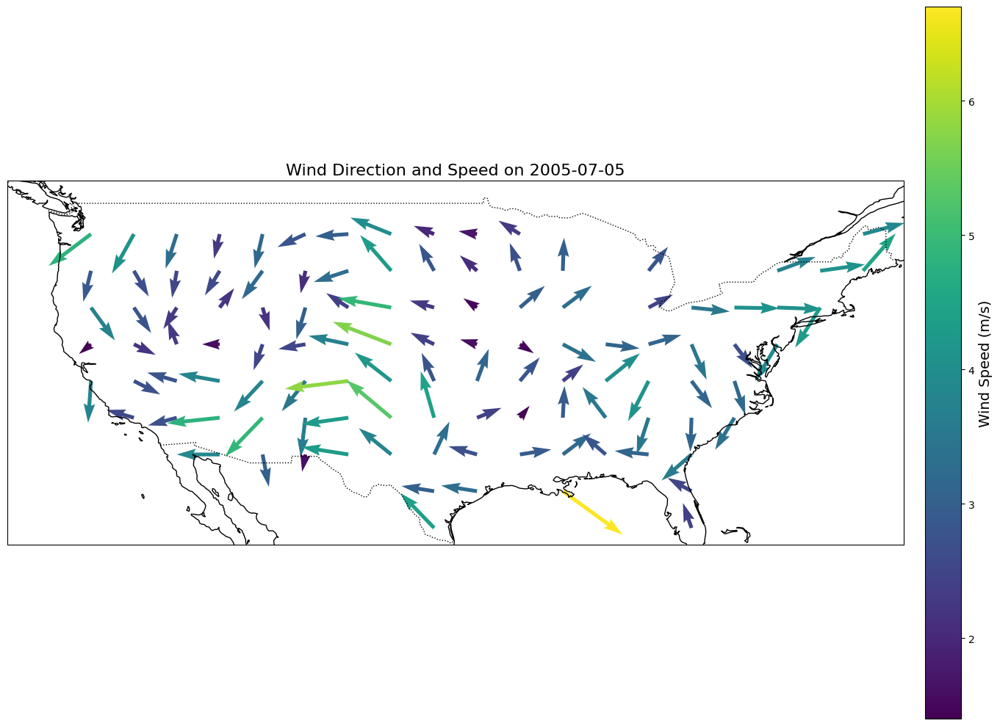

<Figure size 640x480 with 0 Axes>

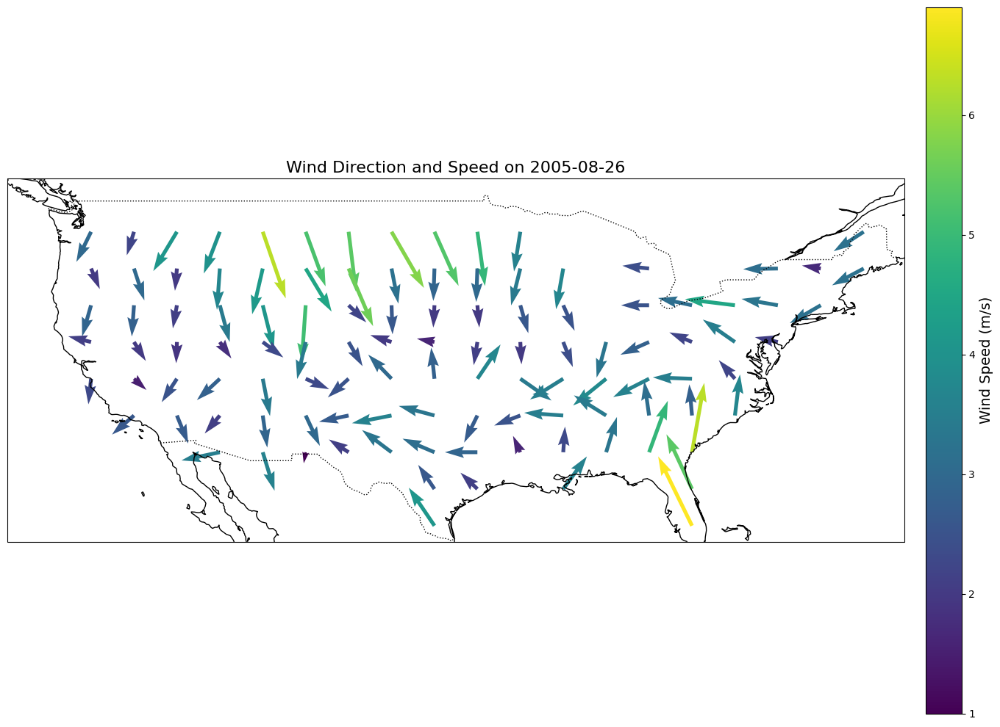

<Figure size 640x480 with 0 Axes>

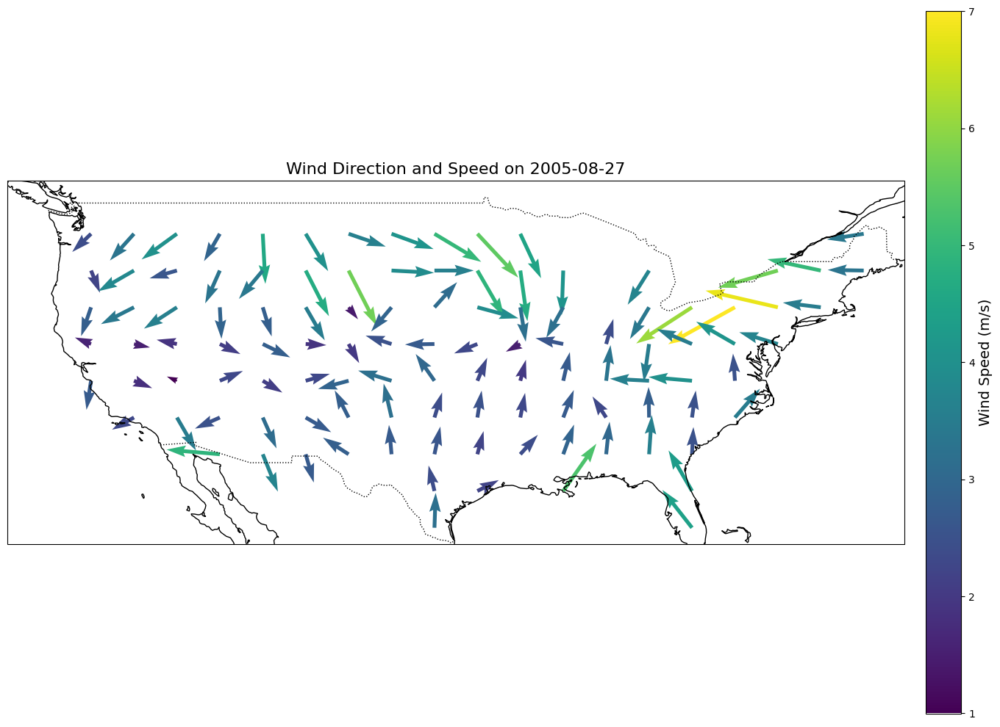

<Figure size 640x480 with 0 Axes>

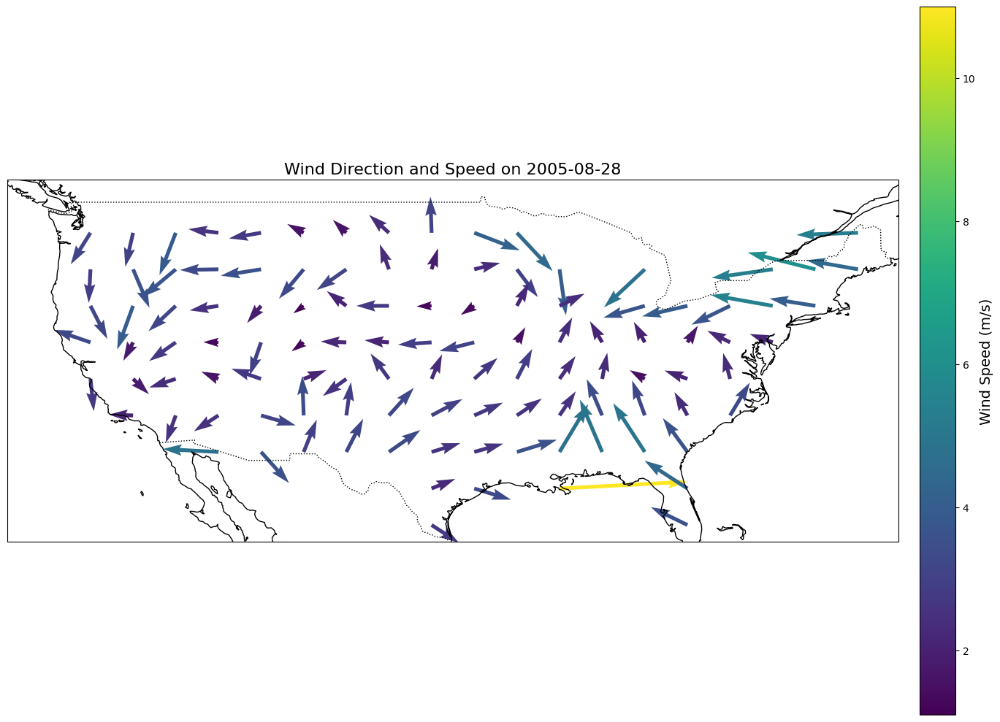

<Figure size 640x480 with 0 Axes>

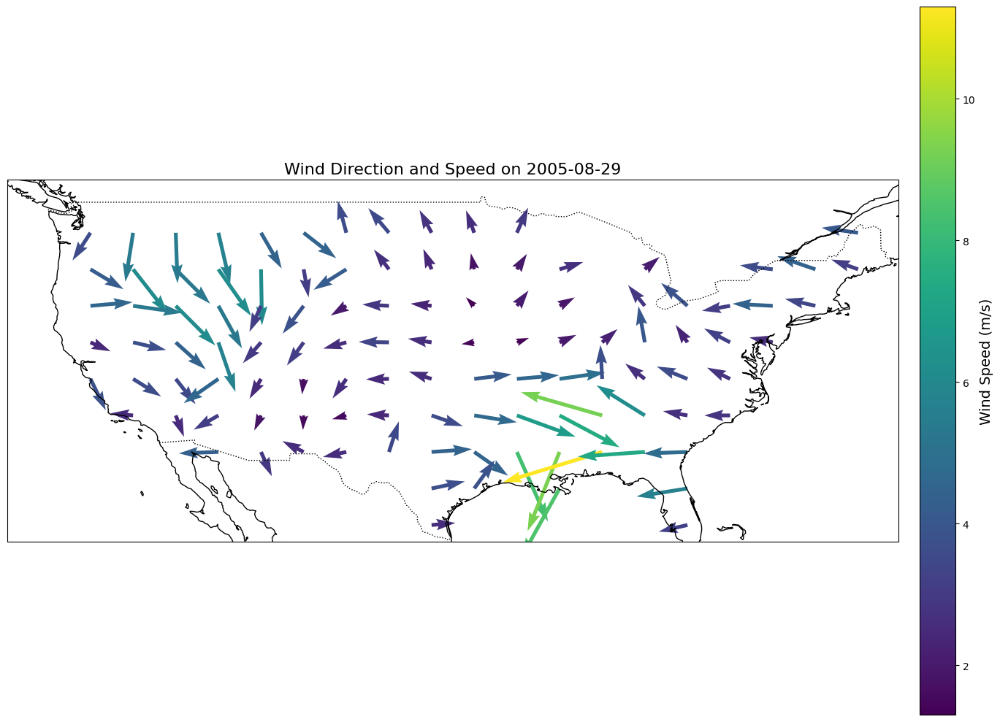

<Figure size 640x480 with 0 Axes>

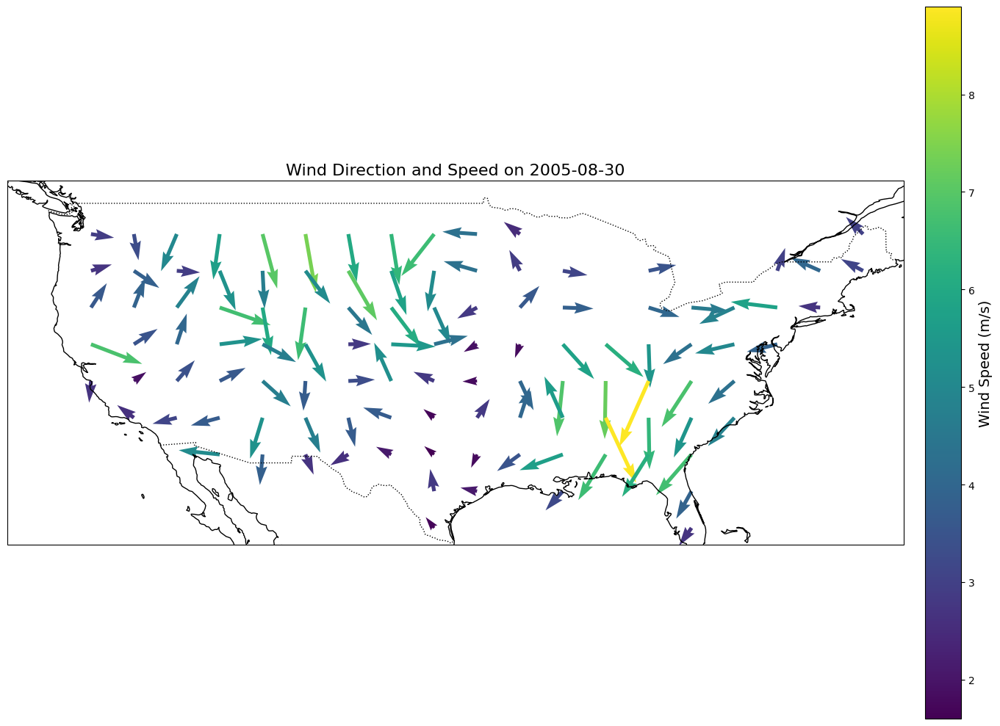

<Figure size 640x480 with 0 Axes>

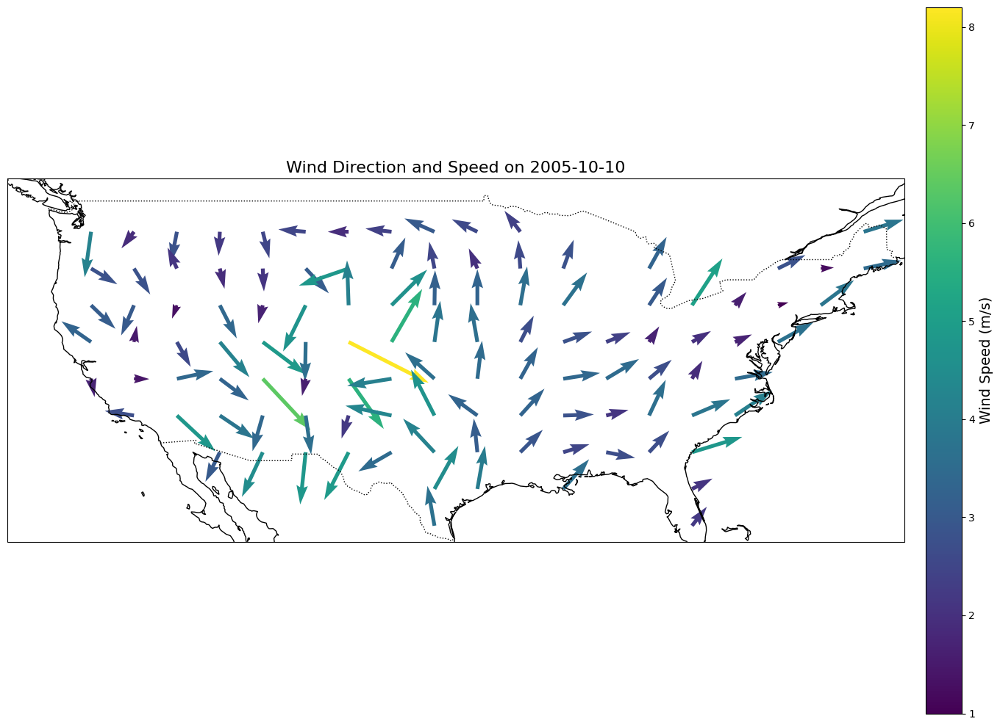

<Figure size 640x480 with 0 Axes>

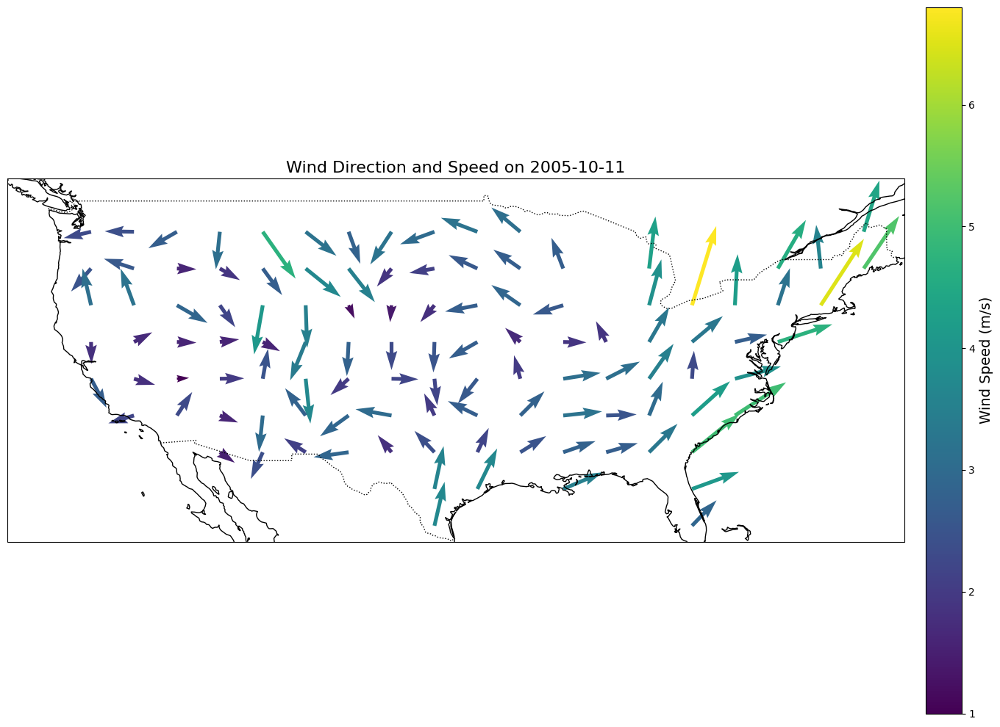

<Figure size 640x480 with 0 Axes>

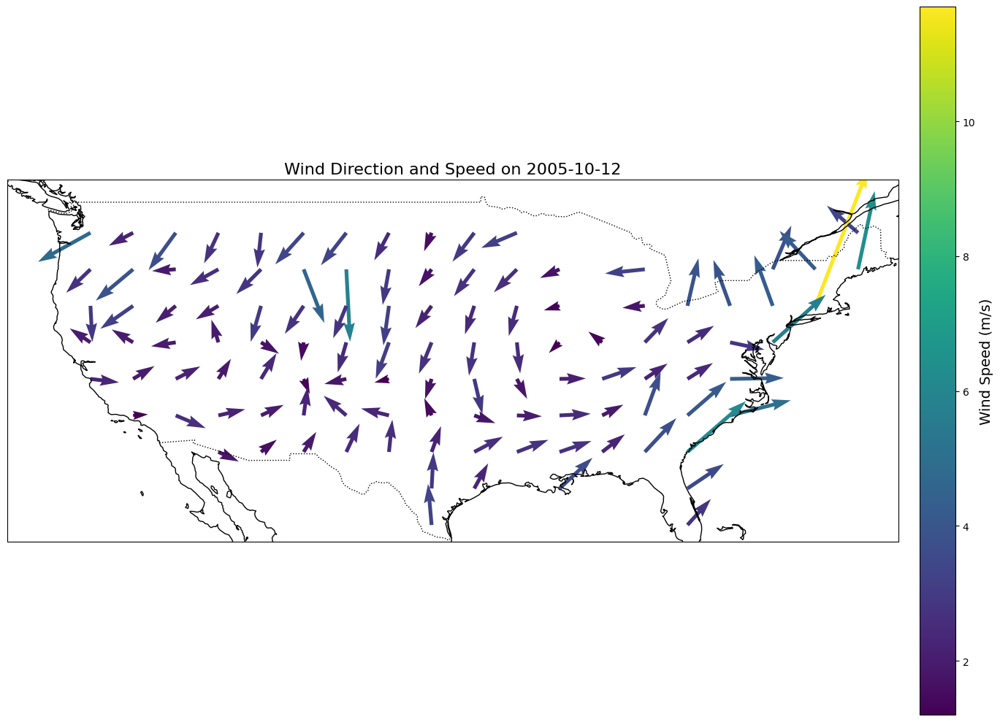

<Figure size 640x480 with 0 Axes>

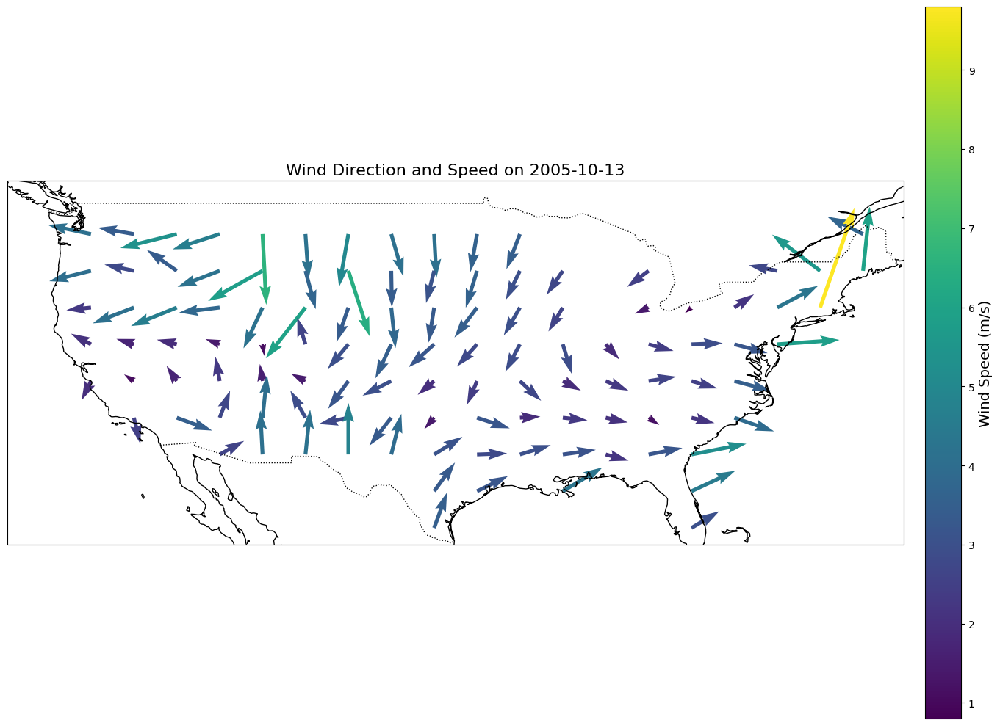

<Figure size 640x480 with 0 Axes>

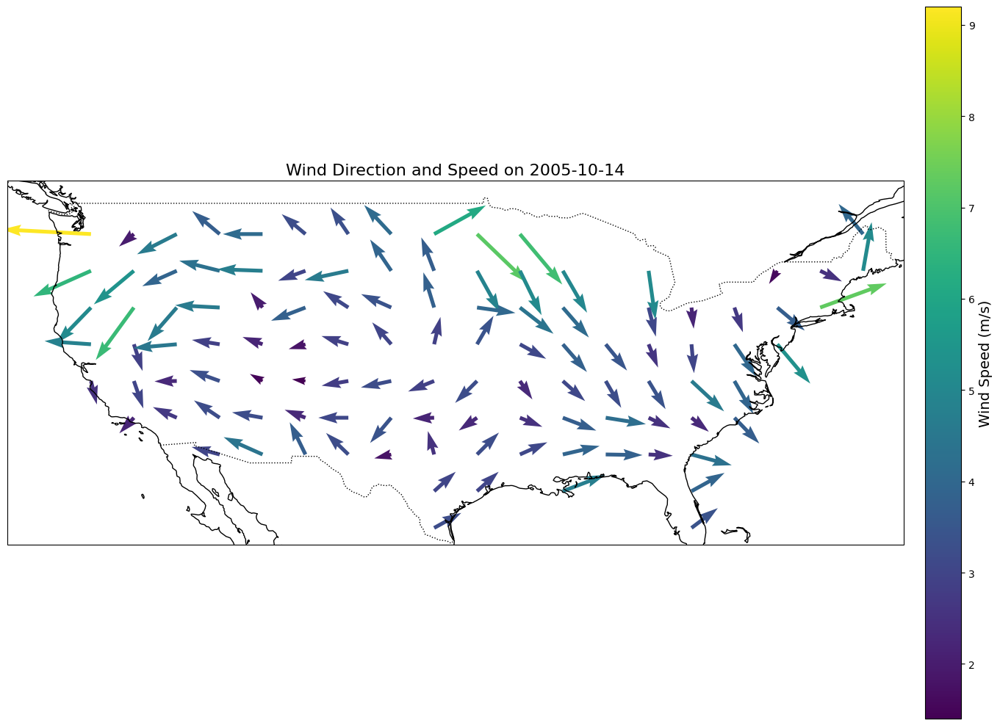

<Figure size 640x480 with 0 Axes>

In [9]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr
import cartopy.crs as ccrs  # Import for map projections and coastlines
import cartopy.feature as cfeature

# Load the .nc files for wind speed (vs) and wind direction (th)
vs_file_path = 'vs_2005.nc'
th_file_path = 'th_2005.nc'

# Open the datasets
vs_data = xr.open_dataset(vs_file_path)
th_data = xr.open_dataset(th_file_path)

# Define the days for each month to plot (5 days in July, August, September)
days_july = ["2005-07-01", "2005-07-02", "2005-07-03", "2005-07-04", "2005-07-05"]
days_september = ["2005-08-26", "2005-08-27", "2005-08-28", "2005-08-29", "2005-08-30"]
days_october = ["2005-10-10", "2005-10-11", "2005-10-12", "2005-10-13", "2005-10-14"]
selected_days = days_july + days_september + days_october

# Extract data for selected days
vs_selected = vs_data.sel(day=selected_days)
th_selected = th_data.sel(day=selected_days)

for day in selected_days:
    # Create a new figure for each day
    fig, ax = plt.subplots(figsize=(15, 10), subplot_kw={'projection': ccrs.PlateCarree()})  # Set figure size
    
    # Get wind speed and direction data for the day
    wind_speed = vs_selected.wind_speed.sel(day=day)
    wind_direction = th_selected.wind_from_direction.sel(day=day)
    
    # Convert direction (degrees) to radians for U and V wind component calculations
    theta = np.deg2rad(wind_direction)
    u = wind_speed * np.cos(theta)
    v = wind_speed * np.sin(theta)
    
    # Select a subset of data for visualization (sparse for clarity)
    lon = wind_speed.lon[::70]  # Sample every 20th for better visualization
    lat = wind_speed.lat[::60]
    u = u[::60, ::70]
    v = v[::60, ::70]
    speed = wind_speed[::60, ::70]
    
    # Plot the quiver with map outlines
    quiver = ax.quiver(lon, lat, u, v, speed, cmap='viridis', transform=ccrs.PlateCarree())
    ax.set_title(f"Wind Direction and Speed on {day}", fontsize=16)
    
    # Add map features
    ax.coastlines()  # Add coastlines
    ax.add_feature(cfeature.BORDERS, linestyle=':')  # Add borders

    # Color bar
    cbar = plt.colorbar(quiver, ax=ax, orientation='vertical', pad=0.02)
    cbar.set_label("Wind Speed (m/s)", fontsize=14)

    plt.tight_layout()
    plt.show()  # Display each plot individually

    # Save each plot individually
    plt.savefig(f"wind_far_plot_{day}.png", bbox_inches='tight')  # Save the figure with the date in the filename
    plt.close(fig)  # Close the figure to free memory


In [10]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import imageio  # Library for creating GIFs

# Load the .nc files for wind speed (vs) and wind direction (th)
vs_file_path = 'vs_2005.nc'
th_file_path = 'th_2005.nc'

# Open the datasets
vs_data = xr.open_dataset(vs_file_path)
th_data = xr.open_dataset(th_file_path)

# Define selected days for the animation (5-10 temporal samples)
selected_days = ["2005-07-01", "2005-07-02", "2005-07-03", "2005-08-28", "2005-08-29", "2005-10-10"]

# Extract data for selected days
vs_selected = vs_data.sel(day=selected_days)
th_selected = th_data.sel(day=selected_days)

# List to store file paths of saved frames for GIF creation
frames = []

# Generate plots for each selected day
for day in selected_days:
    # Create a figure for each frame
    fig, ax = plt.subplots(figsize=(15, 10), subplot_kw={'projection': ccrs.PlateCarree()})
    
    # Get wind speed and direction data for the day
    wind_speed = vs_selected.wind_speed.sel(day=day)
    wind_direction = th_selected.wind_from_direction.sel(day=day)
    
    # Convert direction to radians for U and V wind component calculations
    theta = np.deg2rad(wind_direction)
    u = wind_speed * np.cos(theta)
    v = wind_speed * np.sin(theta)
    
    # Sample data for better visualization
    lon = wind_speed.lon[::40]
    lat = wind_speed.lat[::30]
    u = u[::30, ::40]
    v = v[::30, ::40]
    
    # Plot the wind vectors
    quiver = ax.quiver(lon, lat, u, v, color='black', transform=ccrs.PlateCarree())
    ax.set_title(f"Wind Direction and Speed on {day}", fontsize=16)
    ax.coastlines()
    ax.add_feature(cfeature.BORDERS, linestyle=':')
    
    # Save each frame as a PNG file
    frame_path = f"frame_{day}.png"
    plt.savefig(frame_path, bbox_inches='tight')
    frames.append(frame_path)  # Append to frames list
    plt.close(fig)  # Close to free memory

# Create GIF from saved frames
with imageio.get_writer('wind_animation.gif', mode='I', duration=10) as writer:
    for frame_path in frames:
        image = imageio.imread(frame_path)
        writer.append_data(image)

print("GIF animation has been saved as 'wind_animation.gif'.")


GIF animation has been saved as 'wind_animation.gif'.


/var/folders/nt/xg5gfpkj58vgy8hqhlsslg_m0000gn/T/ipykernel_92953/1810321158.py:61: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(frame_path)


/var/folders/nt/xg5gfpkj58vgy8hqhlsslg_m0000gn/T/ipykernel_92953/2563366363.py:71: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.03, 0.9, 0.97])


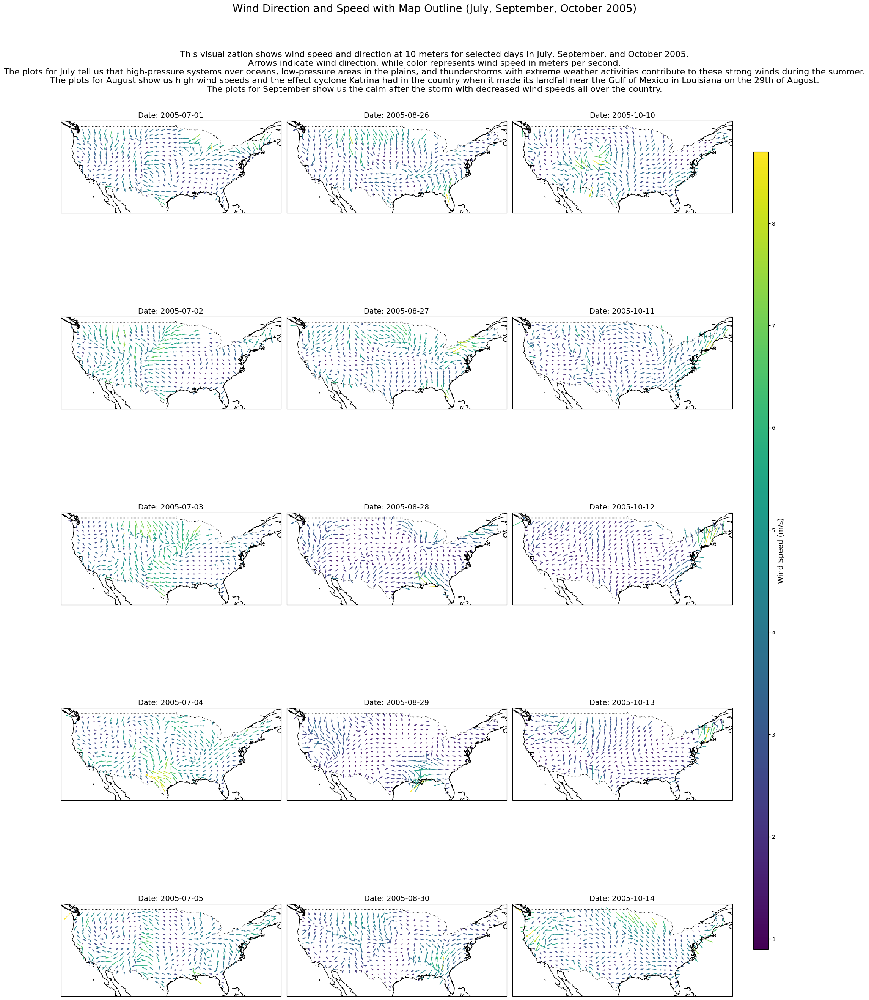

In [11]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr
import cartopy.crs as ccrs  # Import for map projections and coastlines
import cartopy.feature as cfeature

# Load the .nc files for wind speed (vs) and wind direction (th)
vs_file_path = 'vs_2005.nc'
th_file_path = 'th_2005.nc'

# Open the datasets
vs_data = xr.open_dataset(vs_file_path)
th_data = xr.open_dataset(th_file_path)

# Define the days for each month to plot (5 days in July, August, September)
days_july = ["2005-07-01", "2005-07-02", "2005-07-03", "2005-07-04", "2005-07-05"]
days_september = ["2005-08-26", "2005-08-27", "2005-08-28", "2005-08-29", "2005-08-30"]
days_october = ["2005-10-10", "2005-10-11", "2005-10-12", "2005-10-13", "2005-10-14"]
selected_days = days_july + days_september + days_october

# Extract data for selected days
vs_selected = vs_data.sel(day=selected_days)
th_selected = th_data.sel(day=selected_days)

# Prepare quiver plots with a larger figure size and cartopy projection
fig, axes = plt.subplots(5, 3, figsize=(20, 30), subplot_kw={'projection': ccrs.PlateCarree()})  # Increased figsize
fig.suptitle("Wind Direction and Speed with Map Outline (July, September, October 2005)", fontsize=20)


# Adding additional text between the title and plots
fig.text(0.5, 0.92, "This visualization shows wind speed and direction at 10 meters for selected days in July, September, and October 2005.\n"
                    "Arrows indicate wind direction, while color represents wind speed in meters per second.\n"
                    "The plots for July tell us that high-pressure systems over oceans, low-pressure areas in the plains, and thunderstorms with extreme weather activities contribute to these strong winds during the summer.\n"
                    "The plots for August show us high wind speeds and the effect cyclone Katrina had in the country when it made its landfall near the Gulf of Mexico in Louisiana on the 29th of August.\n"
                    "The plots for September show us the calm after the storm with decreased wind speeds all over the country.",
         ha='center', va='center', fontsize=16)


for i, day in enumerate(selected_days):
    ax = axes[i % 5, i // 5]
    
    # Get wind speed and direction data for the day
    wind_speed = vs_selected.wind_speed.sel(day=day)
    wind_direction = th_selected.wind_from_direction.sel(day=day)
    
    # Convert direction (degrees) to radians for U and V wind component calculations
    theta = np.deg2rad(wind_direction)
    u = wind_speed * np.cos(theta)
    v = wind_speed * np.sin(theta)
    
    # Select a subset of data for visualization (sparse for clarity)
    lon = wind_speed.lon[::40]  # Sample every 40th for better visualization
    lat = wind_speed.lat[::30]
    u = u[::30, ::40]
    v = v[::30, ::40]
    speed = wind_speed[::30, ::40]
    
    # Plot the quiver with map outlines
    quiver = ax.quiver(lon, lat, u, v, speed, cmap='viridis', transform=ccrs.PlateCarree())
    ax.set_title(f"Date: {day}", fontsize=14)
    
    # Add map features
    ax.coastlines()  # Add coastlines
    ax.add_feature(cfeature.BORDERS, linestyle=':')  # Add borders

# Color bar on the side
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # Adjusted position for side placement
cbar = fig.colorbar(quiver, cax=cbar_ax)
cbar.set_label("Wind Speed (m/s)", fontsize=14)

plt.tight_layout(rect=[0, 0.03, 0.9, 0.97])
plt.show()
